# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [100]:
%matplotlib inline

import pickle as pkl


import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from scipy.io import loadmat

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat('data/train_32x32.mat')
testset = loadmat('data/test_32x32.mat')

In [5]:
type(trainset)

dict

In [6]:
trainset['X'][0]

array([[[ 33,  84,  19, ...,  92, 190, 216],
        [ 30,  76,  54, ...,  78, 188, 217],
        [ 38,  59, 110, ..., 101, 191, 212]],

       [[ 15,  86,  20, ...,  94, 205, 221],
        [ 23,  73,  52, ...,  82, 203, 222],
        [ 19,  66, 111, ..., 105, 206, 217]],

       [[ 15,  77,  25, ..., 114, 220, 226],
        [ 17,  78,  57, ..., 101, 218, 227],
        [ 19,  56, 116, ..., 125, 220, 221]],

       ..., 
       [[ 72,  90,  65, ..., 200, 229, 200],
        [ 65,  78, 144, ..., 201, 231, 199],
        [ 56,  69, 223, ..., 203, 224, 191]],

       [[ 82,  88,  78, ..., 192, 229, 193],
        [ 77,  77, 148, ..., 193, 229, 188],
        [ 57,  67, 218, ..., 195, 224, 182]],

       [[ 89,  88,  98, ..., 190, 229, 197],
        [ 79,  78, 158, ..., 191, 228, 189],
        [ 59,  66, 220, ..., 193, 223, 186]]], dtype=uint8)

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

In [7]:
trainset['X'].shape, testset['X'].shape

((32, 32, 3, 73257), (32, 32, 3, 26032))

In [8]:
trainset['y'].shape, testset['y'].shape

((73257, 1), (26032, 1))

In [9]:
len(testset['y']), testset['y'].shape[0]

(26032, 26032)

In [10]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
idx

array([72016,   161, 67688,  5727, 21237, 18625, 22299,  9244, 23813,
       21202, 34594, 65480, 50093,  4919, 13201, 42665, 54008, 13351,
        9737,   412, 31904, 71730, 45993,  9715, 63449, 68324, 68175,
       16585, 51328, 68144, 70249, 64054, 60214, 38542, 40041, 29098])

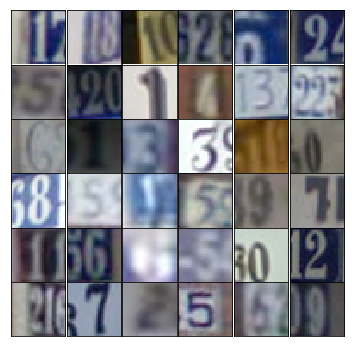

In [11]:
fig, axes = plt.subplots(6, 6, figsize=(6,6))
for i, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,i])
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [12]:
def scale(x, feature_range=(-1,1)):
    # pixels are between 0 and 255, so we first bring them to the range 0 to 1
    xmin = x.min()
    x = (x - xmin)/(255 - xmin)
    
    fmin, fmax = feature_range
    x = x * (fmax - fmin) + fmin
    return x

In [13]:
class Dataset:
    def __init__(self, train, test, val_frac=.5, shuffle=False, scale_func=None):
        
        self.train_x, self.train_y = train['X'], train['y']
        
        split_indx = int(test['y'].shape[0] * (1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_indx], test['X'][:,:,:,split_indx:]
        self.test_y, self.valid_y = test['y'][:split_indx], test['y'][split_indx:]
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
            
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        n_batches = len(self.train_y)//batch_size
        for i in range(0, len(self.train_y), batch_size):
            x = self.train_x[i:i+batch_size]
            y = self.train_y[i:i+batch_size]
            
            yield self.scaler(x),y

## Network Inputs

Here, just creating some placeholders like normal.

In [14]:
def model_inputs(real_dim, z_dim):
    input_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    input_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return input_real, input_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

### **Note:** Strides define the impact on height and width, filters define the feature len

In [15]:
def generator(z, output_dim, reuse=False, alpha=.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, (-1,4,4,512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # x1 shape => (4x4x512)

        x2 = tf.layers.conv2d_transpose(x1, filters=256, kernel_size=5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # x2 shape => (8x8x256)

        x3 = tf.layers.conv2d_transpose(x2, filters=128, kernel_size=5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # x3 shape => (16x16x128)

        logits = tf.layers.conv2d_transpose(x3, filters=output_dim, kernel_size=5, strides=2, padding='same')
        # logits shape => (32x32x3)

        out = tf.tanh(logits)

        return out
    

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [16]:
def discriminator(x, reuse=False, alpha=.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # input => 32x32x3
        x1 = tf.layers.conv2d(x, filters=64, kernel_size=5, strides=2, padding='same')
        x1 = tf.maximum(alpha * x1, x1)
        # x1 => 16x16x64
        
        x2 = tf.layers.conv2d(x1, filters=128, kernel_size=5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        # x2 => 8x8x128
        
        x3 = tf.layers.conv2d(x2, filters=256, kernel_size=5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        # x3 => 4x4x256

        flat = tf.reshape(x3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [17]:
# def model_loss(input_real, input_z, output_dim, alpha=0.2):
    
#     g_model = generator(input_z, output_dim, alpha=alpha)
#     d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
#     d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)
    
#     g_loss = tf.reduce_mean(
#         tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_logits_real)))
#     d_loss_real = tf.reduce_mean(
#         tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_logits_real)))
#     d_loss_fake = tf.reduce_mean(
#         tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_logits_fake)))

    
#     d_loss = d_loss_real + d_loss_fake
    
#     return d_loss, g_loss 

In [18]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [19]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    t_vars = tf.trainable_variables()
    g_vars = [x for x in t_vars if x.name.startswith('generator')]
    d_vars = [x for x in t_vars if x.name.startswith('discriminator')]
    
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
        
    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [20]:
class GAN:
    def __init__(self, real_dim, z_dim, learning_rate, alpha=.2, beta1=.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_dim, z_dim)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z, real_dim[2],alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)
        

Here is a function for displaying generated images.

In [ ]:
# def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
#     fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
#                              sharey=True, sharex=True)
#     for ax, img in zip(axes.flatten(), samples[epoch]):
#         ax.axis('off')
#         img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
#         ax.set_adjustable('box-forced')
#         im = ax.imshow(img, aspect='equal')
   
#     plt.subplots_adjust(wspace=0, hspace=0)
#     return fig, axes

In [56]:
def view_samples(epoch, samples, rows, cols, figsize=(5,5)):
    
    fig, axes = plt.subplots(figsize=figsize, nrows=rows, ncols=cols, sharex=True, sharey=True)
    
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        ax.imshow(img, aspect='equal')
        
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [57]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))
    
    samples = []
    losses = []
    
    steps = 0
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps+=1
                
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))
                
                _ = sess.run(net.d_opt, feed_dict={net.input_real:x, net.input_z:batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_real:x, net.input_z:batch_z})
                
                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [101]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.001
batch_size = 128
epochs = 20
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

In [102]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)


Epoch 1/20... Discriminator Loss: 0.1528... Generator Loss: 16.0037
Epoch 1/20... Discriminator Loss: 0.1278... Generator Loss: 13.4208
Epoch 1/20... Discriminator Loss: 0.2702... Generator Loss: 2.3606
Epoch 1/20... Discriminator Loss: 0.8394... Generator Loss: 1.1349
Epoch 1/20... Discriminator Loss: 1.3756... Generator Loss: 1.7803
Epoch 1/20... Discriminator Loss: 2.6696... Generator Loss: 4.0584
Epoch 1/20... Discriminator Loss: 0.9403... Generator Loss: 2.3505
Epoch 1/20... Discriminator Loss: 1.1575... Generator Loss: 0.5913
Epoch 1/20... Discriminator Loss: 0.9784... Generator Loss: 3.0500
Epoch 1/20... Discriminator Loss: 0.6892... Generator Loss: 2.1768


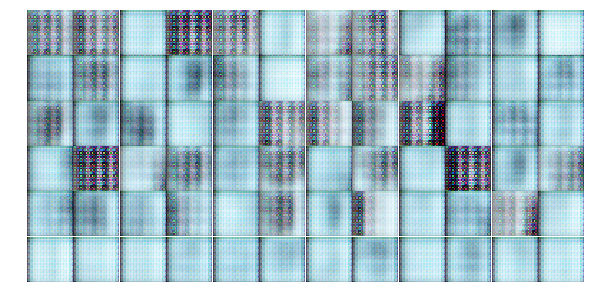

Epoch 1/20... Discriminator Loss: 0.7502... Generator Loss: 1.2115
Epoch 1/20... Discriminator Loss: 0.6850... Generator Loss: 1.3230
Epoch 1/20... Discriminator Loss: 0.6618... Generator Loss: 2.5267
Epoch 1/20... Discriminator Loss: 1.7632... Generator Loss: 4.7336
Epoch 1/20... Discriminator Loss: 1.0957... Generator Loss: 0.6641
Epoch 1/20... Discriminator Loss: 1.6606... Generator Loss: 0.6222
Epoch 1/20... Discriminator Loss: 0.7202... Generator Loss: 1.3456
Epoch 1/20... Discriminator Loss: 0.5184... Generator Loss: 2.1722
Epoch 1/20... Discriminator Loss: 1.2760... Generator Loss: 0.5866
Epoch 1/20... Discriminator Loss: 1.3756... Generator Loss: 0.6827


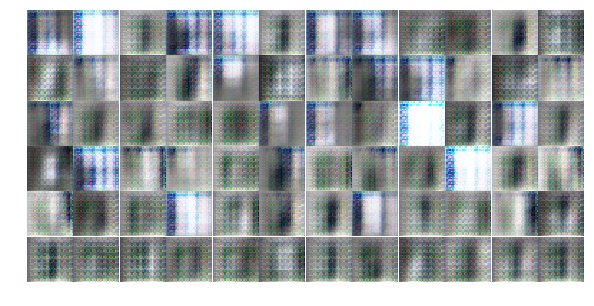

Epoch 1/20... Discriminator Loss: 0.4218... Generator Loss: 1.7220
Epoch 1/20... Discriminator Loss: 0.7471... Generator Loss: 0.9720
Epoch 1/20... Discriminator Loss: 0.7613... Generator Loss: 0.8536
Epoch 1/20... Discriminator Loss: 1.4035... Generator Loss: 0.7044
Epoch 1/20... Discriminator Loss: 0.9638... Generator Loss: 0.9673
Epoch 1/20... Discriminator Loss: 1.4362... Generator Loss: 0.8208
Epoch 1/20... Discriminator Loss: 1.6137... Generator Loss: 0.7502
Epoch 1/20... Discriminator Loss: 0.6647... Generator Loss: 1.3597
Epoch 1/20... Discriminator Loss: 1.7091... Generator Loss: 0.4010
Epoch 1/20... Discriminator Loss: 1.0532... Generator Loss: 0.9751


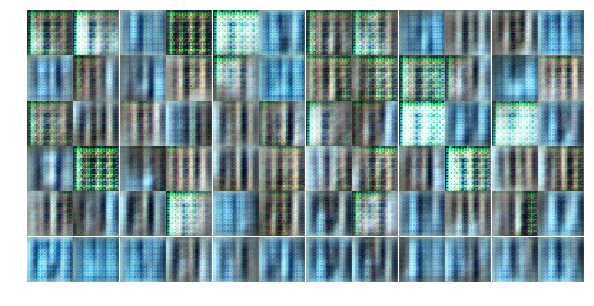

Epoch 1/20... Discriminator Loss: 1.1468... Generator Loss: 0.8372
Epoch 1/20... Discriminator Loss: 1.1354... Generator Loss: 0.9044
Epoch 1/20... Discriminator Loss: 0.9420... Generator Loss: 1.0575
Epoch 1/20... Discriminator Loss: 0.7304... Generator Loss: 1.6090
Epoch 1/20... Discriminator Loss: 1.3223... Generator Loss: 1.1399
Epoch 1/20... Discriminator Loss: 1.4878... Generator Loss: 2.3002
Epoch 1/20... Discriminator Loss: 1.3071... Generator Loss: 0.8104
Epoch 1/20... Discriminator Loss: 0.8112... Generator Loss: 2.0897
Epoch 1/20... Discriminator Loss: 2.1631... Generator Loss: 0.5977
Epoch 1/20... Discriminator Loss: 1.0624... Generator Loss: 0.8528


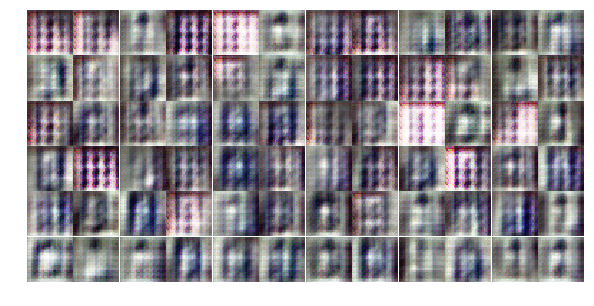

Epoch 1/20... Discriminator Loss: 1.5097... Generator Loss: 2.5425
Epoch 1/20... Discriminator Loss: 1.2945... Generator Loss: 0.8486
Epoch 1/20... Discriminator Loss: 1.2244... Generator Loss: 0.9059
Epoch 1/20... Discriminator Loss: 1.4125... Generator Loss: 1.4159
Epoch 1/20... Discriminator Loss: 1.0056... Generator Loss: 1.0721
Epoch 1/20... Discriminator Loss: 2.7497... Generator Loss: 0.1595
Epoch 1/20... Discriminator Loss: 1.1659... Generator Loss: 1.0397
Epoch 1/20... Discriminator Loss: 1.2421... Generator Loss: 0.8773
Epoch 1/20... Discriminator Loss: 1.3793... Generator Loss: 1.1018
Epoch 1/20... Discriminator Loss: 1.1314... Generator Loss: 1.0060


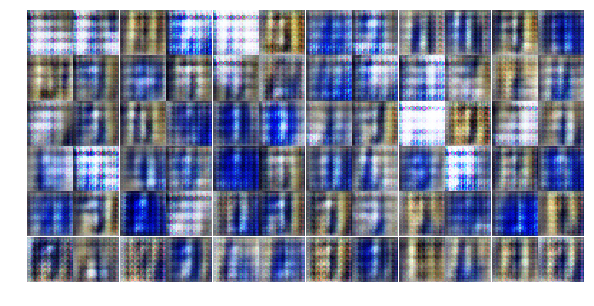

Epoch 1/20... Discriminator Loss: 1.0826... Generator Loss: 0.9524
Epoch 1/20... Discriminator Loss: 1.4234... Generator Loss: 0.8190
Epoch 1/20... Discriminator Loss: 1.2906... Generator Loss: 0.7950
Epoch 1/20... Discriminator Loss: 1.2067... Generator Loss: 0.7896
Epoch 1/20... Discriminator Loss: 1.3265... Generator Loss: 0.9964
Epoch 1/20... Discriminator Loss: 1.3377... Generator Loss: 0.7959
Epoch 1/20... Discriminator Loss: 1.3145... Generator Loss: 0.8333
Epoch 2/20... Discriminator Loss: 1.3958... Generator Loss: 0.9482
Epoch 2/20... Discriminator Loss: 1.1831... Generator Loss: 0.8299
Epoch 2/20... Discriminator Loss: 1.4683... Generator Loss: 0.8929


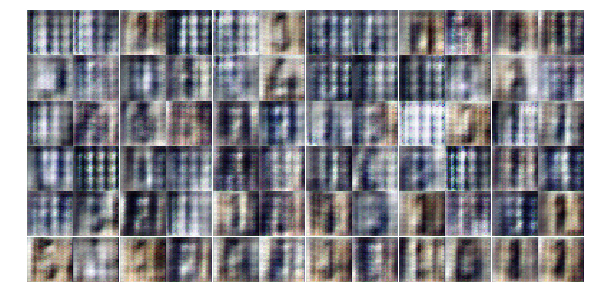

Epoch 2/20... Discriminator Loss: 1.1915... Generator Loss: 1.0773
Epoch 2/20... Discriminator Loss: 1.3209... Generator Loss: 0.7957
Epoch 2/20... Discriminator Loss: 1.1664... Generator Loss: 0.8322
Epoch 2/20... Discriminator Loss: 1.3105... Generator Loss: 0.7856
Epoch 2/20... Discriminator Loss: 1.1359... Generator Loss: 0.9944
Epoch 2/20... Discriminator Loss: 1.0372... Generator Loss: 0.9507
Epoch 2/20... Discriminator Loss: 1.9108... Generator Loss: 0.2371
Epoch 2/20... Discriminator Loss: 1.9691... Generator Loss: 0.3403
Epoch 2/20... Discriminator Loss: 1.1165... Generator Loss: 0.8618
Epoch 2/20... Discriminator Loss: 1.5094... Generator Loss: 0.5277


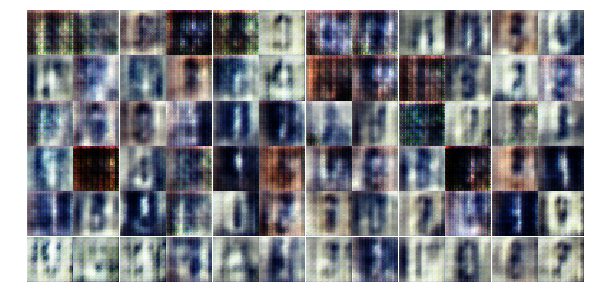

Epoch 2/20... Discriminator Loss: 1.2404... Generator Loss: 0.8458
Epoch 2/20... Discriminator Loss: 1.2541... Generator Loss: 0.8896
Epoch 2/20... Discriminator Loss: 1.2153... Generator Loss: 0.8287
Epoch 2/20... Discriminator Loss: 1.3806... Generator Loss: 0.7272
Epoch 2/20... Discriminator Loss: 1.2256... Generator Loss: 0.8109
Epoch 2/20... Discriminator Loss: 1.7481... Generator Loss: 1.8350
Epoch 2/20... Discriminator Loss: 1.3007... Generator Loss: 0.7828
Epoch 2/20... Discriminator Loss: 1.3860... Generator Loss: 0.9334
Epoch 2/20... Discriminator Loss: 1.2045... Generator Loss: 0.8047
Epoch 2/20... Discriminator Loss: 1.7304... Generator Loss: 0.3313


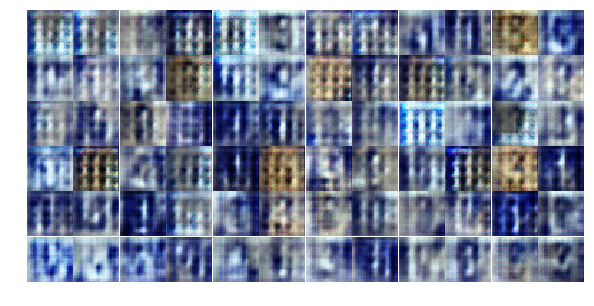

Epoch 2/20... Discriminator Loss: 1.4351... Generator Loss: 0.6751
Epoch 2/20... Discriminator Loss: 1.3990... Generator Loss: 0.6669
Epoch 2/20... Discriminator Loss: 1.7254... Generator Loss: 0.5058
Epoch 2/20... Discriminator Loss: 1.2576... Generator Loss: 1.6009
Epoch 2/20... Discriminator Loss: 1.4831... Generator Loss: 0.9030
Epoch 2/20... Discriminator Loss: 1.3692... Generator Loss: 1.8921
Epoch 2/20... Discriminator Loss: 1.3237... Generator Loss: 0.8709
Epoch 2/20... Discriminator Loss: 1.1772... Generator Loss: 0.8347
Epoch 2/20... Discriminator Loss: 1.2783... Generator Loss: 0.7344
Epoch 2/20... Discriminator Loss: 0.9652... Generator Loss: 1.1554


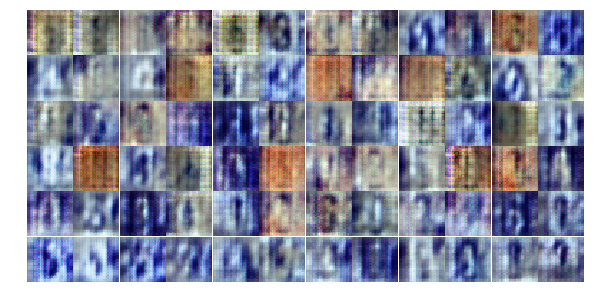

Epoch 2/20... Discriminator Loss: 1.6360... Generator Loss: 1.6708
Epoch 2/20... Discriminator Loss: 1.1550... Generator Loss: 0.9155
Epoch 2/20... Discriminator Loss: 1.1349... Generator Loss: 0.7750
Epoch 2/20... Discriminator Loss: 1.6528... Generator Loss: 0.3123
Epoch 2/20... Discriminator Loss: 1.4463... Generator Loss: 0.7657
Epoch 2/20... Discriminator Loss: 1.3909... Generator Loss: 0.7068
Epoch 2/20... Discriminator Loss: 1.1729... Generator Loss: 1.0242
Epoch 2/20... Discriminator Loss: 1.3288... Generator Loss: 1.0923
Epoch 2/20... Discriminator Loss: 1.1944... Generator Loss: 0.9031
Epoch 2/20... Discriminator Loss: 1.3831... Generator Loss: 0.6503


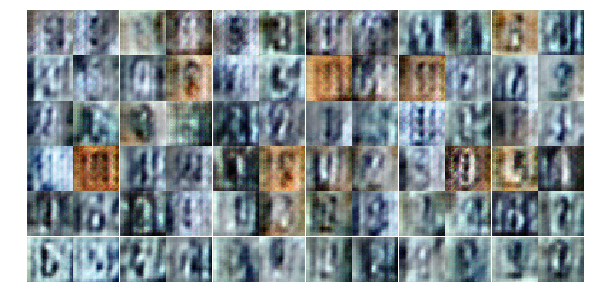

Epoch 2/20... Discriminator Loss: 1.0666... Generator Loss: 0.9190
Epoch 2/20... Discriminator Loss: 1.4887... Generator Loss: 0.6706
Epoch 2/20... Discriminator Loss: 1.3398... Generator Loss: 0.5330
Epoch 2/20... Discriminator Loss: 1.2475... Generator Loss: 0.8037
Epoch 2/20... Discriminator Loss: 1.3062... Generator Loss: 0.9626
Epoch 2/20... Discriminator Loss: 1.2143... Generator Loss: 0.8047
Epoch 2/20... Discriminator Loss: 1.1463... Generator Loss: 0.8999
Epoch 2/20... Discriminator Loss: 1.3803... Generator Loss: 0.9327
Epoch 2/20... Discriminator Loss: 1.4908... Generator Loss: 0.5791
Epoch 2/20... Discriminator Loss: 1.2562... Generator Loss: 0.9878


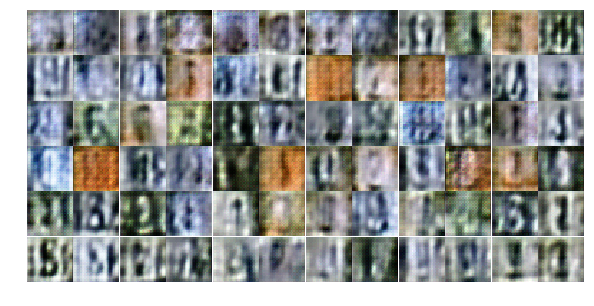

Epoch 2/20... Discriminator Loss: 1.2993... Generator Loss: 0.8335
Epoch 2/20... Discriminator Loss: 1.2874... Generator Loss: 0.9526
Epoch 2/20... Discriminator Loss: 1.0568... Generator Loss: 0.8796
Epoch 2/20... Discriminator Loss: 1.1670... Generator Loss: 0.8335
Epoch 3/20... Discriminator Loss: 1.2642... Generator Loss: 1.2159
Epoch 3/20... Discriminator Loss: 1.1380... Generator Loss: 0.8846
Epoch 3/20... Discriminator Loss: 1.4217... Generator Loss: 0.7907
Epoch 3/20... Discriminator Loss: 1.5121... Generator Loss: 0.6265
Epoch 3/20... Discriminator Loss: 1.2611... Generator Loss: 0.7212
Epoch 3/20... Discriminator Loss: 1.1587... Generator Loss: 0.6467


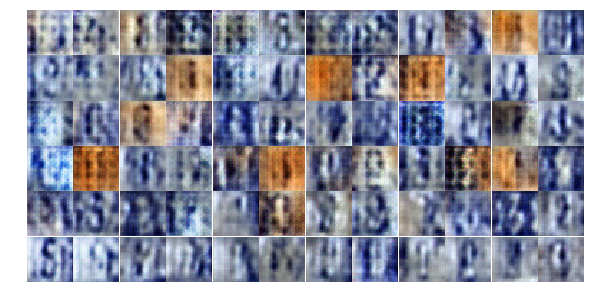

Epoch 3/20... Discriminator Loss: 1.3976... Generator Loss: 0.7718
Epoch 3/20... Discriminator Loss: 1.5492... Generator Loss: 0.7707
Epoch 3/20... Discriminator Loss: 1.1658... Generator Loss: 0.9136
Epoch 3/20... Discriminator Loss: 1.4133... Generator Loss: 0.7370
Epoch 3/20... Discriminator Loss: 1.2798... Generator Loss: 0.7727
Epoch 3/20... Discriminator Loss: 0.9740... Generator Loss: 1.4116
Epoch 3/20... Discriminator Loss: 1.1864... Generator Loss: 1.0447
Epoch 3/20... Discriminator Loss: 1.2254... Generator Loss: 0.8407
Epoch 3/20... Discriminator Loss: 1.3248... Generator Loss: 0.7337
Epoch 3/20... Discriminator Loss: 1.5103... Generator Loss: 0.4626


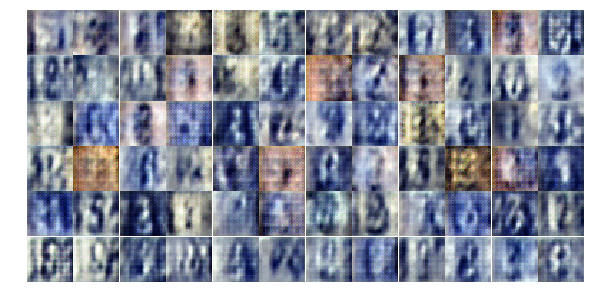

Epoch 3/20... Discriminator Loss: 1.2201... Generator Loss: 1.2094
Epoch 3/20... Discriminator Loss: 1.3343... Generator Loss: 0.7776
Epoch 3/20... Discriminator Loss: 1.2588... Generator Loss: 0.7531
Epoch 3/20... Discriminator Loss: 1.2797... Generator Loss: 0.8607
Epoch 3/20... Discriminator Loss: 1.2673... Generator Loss: 0.8004
Epoch 3/20... Discriminator Loss: 1.3057... Generator Loss: 1.1514
Epoch 3/20... Discriminator Loss: 1.4119... Generator Loss: 0.6255
Epoch 3/20... Discriminator Loss: 1.4635... Generator Loss: 0.7467
Epoch 3/20... Discriminator Loss: 1.2328... Generator Loss: 0.6408
Epoch 3/20... Discriminator Loss: 1.2412... Generator Loss: 1.1758


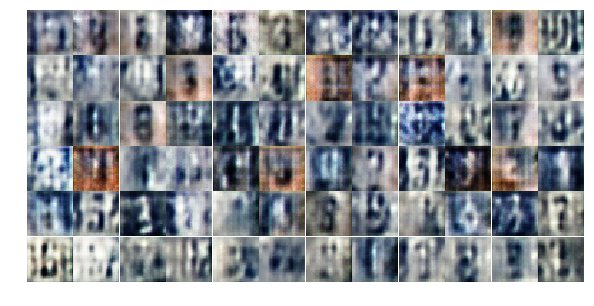

Epoch 3/20... Discriminator Loss: 1.5663... Generator Loss: 0.6319
Epoch 3/20... Discriminator Loss: 1.2187... Generator Loss: 0.6893
Epoch 3/20... Discriminator Loss: 1.2618... Generator Loss: 0.7700
Epoch 3/20... Discriminator Loss: 1.2003... Generator Loss: 0.6998
Epoch 3/20... Discriminator Loss: 1.6055... Generator Loss: 0.3769
Epoch 3/20... Discriminator Loss: 1.1205... Generator Loss: 0.9530
Epoch 3/20... Discriminator Loss: 1.4526... Generator Loss: 0.7927
Epoch 3/20... Discriminator Loss: 1.4351... Generator Loss: 0.6499
Epoch 3/20... Discriminator Loss: 1.1809... Generator Loss: 0.8205
Epoch 3/20... Discriminator Loss: 1.0953... Generator Loss: 1.0007


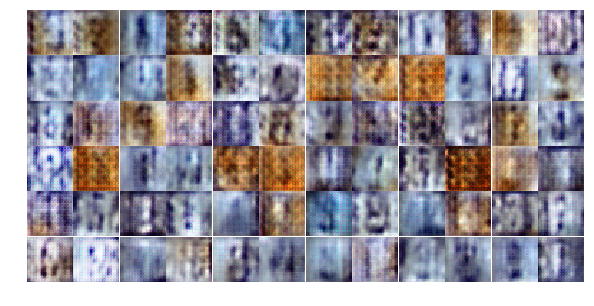

Epoch 3/20... Discriminator Loss: 1.1951... Generator Loss: 0.8378
Epoch 3/20... Discriminator Loss: 1.1488... Generator Loss: 1.2529
Epoch 3/20... Discriminator Loss: 1.1267... Generator Loss: 0.8181
Epoch 3/20... Discriminator Loss: 1.2330... Generator Loss: 0.7589
Epoch 3/20... Discriminator Loss: 1.0252... Generator Loss: 1.0750
Epoch 3/20... Discriminator Loss: 1.3119... Generator Loss: 0.7452
Epoch 3/20... Discriminator Loss: 1.3057... Generator Loss: 1.3571
Epoch 3/20... Discriminator Loss: 1.2297... Generator Loss: 1.2240
Epoch 3/20... Discriminator Loss: 1.0109... Generator Loss: 0.8166
Epoch 3/20... Discriminator Loss: 1.2211... Generator Loss: 0.9633


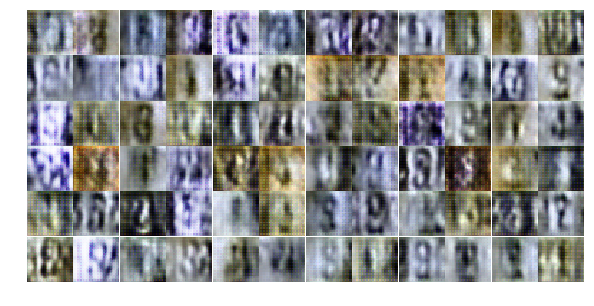

Epoch 3/20... Discriminator Loss: 1.4515... Generator Loss: 0.5912
Epoch 3/20... Discriminator Loss: 1.2768... Generator Loss: 0.6936
Epoch 3/20... Discriminator Loss: 1.2963... Generator Loss: 0.7302
Epoch 3/20... Discriminator Loss: 1.2569... Generator Loss: 1.1524
Epoch 3/20... Discriminator Loss: 1.1260... Generator Loss: 0.8916
Epoch 3/20... Discriminator Loss: 1.0911... Generator Loss: 0.9404
Epoch 3/20... Discriminator Loss: 1.3680... Generator Loss: 1.1621
Epoch 3/20... Discriminator Loss: 0.9618... Generator Loss: 1.1041
Epoch 3/20... Discriminator Loss: 1.3326... Generator Loss: 0.9044
Epoch 3/20... Discriminator Loss: 1.2273... Generator Loss: 0.9919


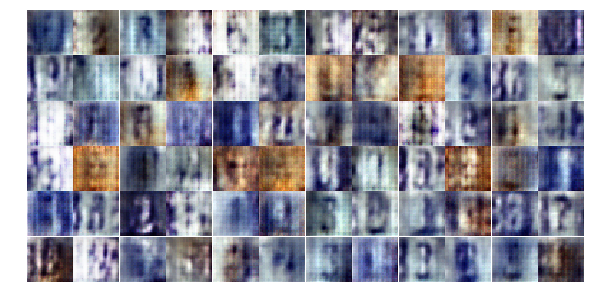

Epoch 3/20... Discriminator Loss: 1.3083... Generator Loss: 0.6934
Epoch 4/20... Discriminator Loss: 1.1613... Generator Loss: 1.0653
Epoch 4/20... Discriminator Loss: 1.2612... Generator Loss: 0.6896
Epoch 4/20... Discriminator Loss: 1.1403... Generator Loss: 0.9938
Epoch 4/20... Discriminator Loss: 1.2690... Generator Loss: 0.9388
Epoch 4/20... Discriminator Loss: 1.2629... Generator Loss: 0.9448
Epoch 4/20... Discriminator Loss: 1.2060... Generator Loss: 0.6591
Epoch 4/20... Discriminator Loss: 1.2078... Generator Loss: 0.7270
Epoch 4/20... Discriminator Loss: 1.2499... Generator Loss: 0.6479
Epoch 4/20... Discriminator Loss: 1.2011... Generator Loss: 0.7928


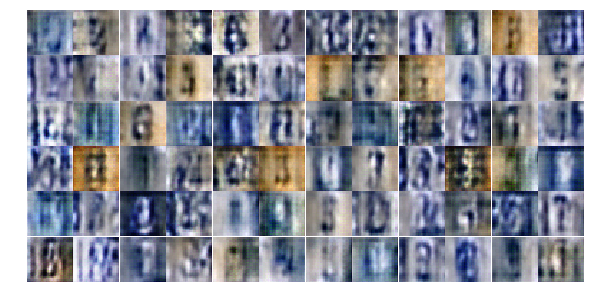

Epoch 4/20... Discriminator Loss: 1.1511... Generator Loss: 1.1087
Epoch 4/20... Discriminator Loss: 1.2434... Generator Loss: 0.5296
Epoch 4/20... Discriminator Loss: 1.2311... Generator Loss: 1.0015
Epoch 4/20... Discriminator Loss: 1.0974... Generator Loss: 0.8334
Epoch 4/20... Discriminator Loss: 1.5869... Generator Loss: 0.3661
Epoch 4/20... Discriminator Loss: 1.1683... Generator Loss: 0.7754
Epoch 4/20... Discriminator Loss: 1.0231... Generator Loss: 1.1108
Epoch 4/20... Discriminator Loss: 1.2805... Generator Loss: 0.8672
Epoch 4/20... Discriminator Loss: 1.4025... Generator Loss: 1.0964
Epoch 4/20... Discriminator Loss: 1.2842... Generator Loss: 1.1658


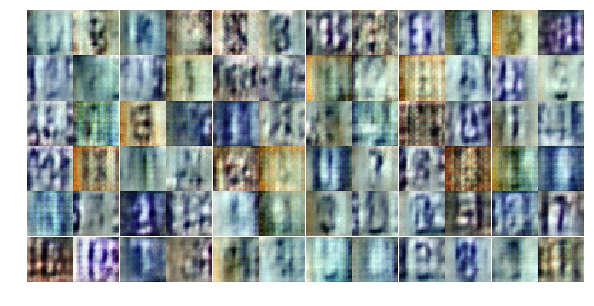

Epoch 4/20... Discriminator Loss: 1.2200... Generator Loss: 0.6490
Epoch 4/20... Discriminator Loss: 1.3640... Generator Loss: 1.5009
Epoch 4/20... Discriminator Loss: 1.3556... Generator Loss: 0.9527
Epoch 4/20... Discriminator Loss: 1.3621... Generator Loss: 0.5425
Epoch 4/20... Discriminator Loss: 1.1340... Generator Loss: 1.2725
Epoch 4/20... Discriminator Loss: 1.1853... Generator Loss: 0.9380
Epoch 4/20... Discriminator Loss: 1.4597... Generator Loss: 0.9892
Epoch 4/20... Discriminator Loss: 0.8110... Generator Loss: 1.0546
Epoch 4/20... Discriminator Loss: 1.0470... Generator Loss: 1.2366
Epoch 4/20... Discriminator Loss: 1.1439... Generator Loss: 0.9643


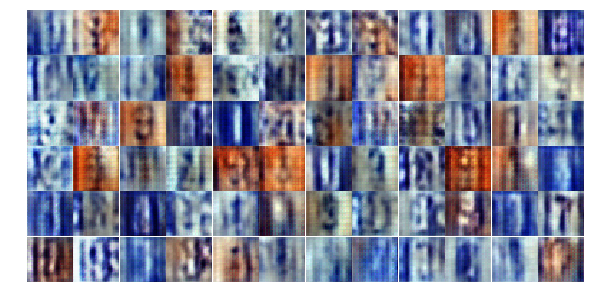

Epoch 4/20... Discriminator Loss: 1.0907... Generator Loss: 0.9055
Epoch 4/20... Discriminator Loss: 0.7837... Generator Loss: 1.1837
Epoch 4/20... Discriminator Loss: 1.0098... Generator Loss: 1.3931
Epoch 4/20... Discriminator Loss: 1.1255... Generator Loss: 0.6379
Epoch 4/20... Discriminator Loss: 1.0715... Generator Loss: 0.7476
Epoch 4/20... Discriminator Loss: 1.0509... Generator Loss: 1.0703
Epoch 4/20... Discriminator Loss: 1.3856... Generator Loss: 0.4984
Epoch 4/20... Discriminator Loss: 1.0032... Generator Loss: 0.8322
Epoch 4/20... Discriminator Loss: 1.0227... Generator Loss: 0.8440
Epoch 4/20... Discriminator Loss: 0.9332... Generator Loss: 0.9238


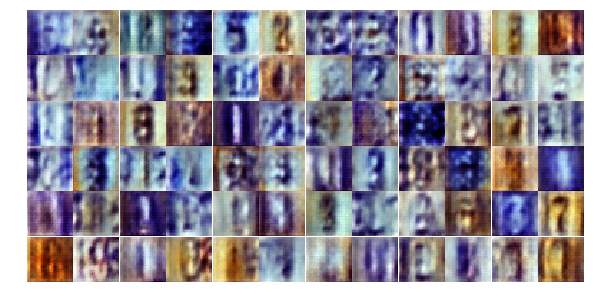

Epoch 4/20... Discriminator Loss: 1.3690... Generator Loss: 0.4753
Epoch 4/20... Discriminator Loss: 1.1193... Generator Loss: 0.8411
Epoch 4/20... Discriminator Loss: 1.1624... Generator Loss: 0.8433
Epoch 4/20... Discriminator Loss: 1.1078... Generator Loss: 1.2602
Epoch 4/20... Discriminator Loss: 1.0174... Generator Loss: 0.9839
Epoch 4/20... Discriminator Loss: 1.4806... Generator Loss: 0.4277
Epoch 4/20... Discriminator Loss: 1.1737... Generator Loss: 0.8453
Epoch 4/20... Discriminator Loss: 1.2002... Generator Loss: 0.7288
Epoch 4/20... Discriminator Loss: 0.9794... Generator Loss: 0.8742
Epoch 4/20... Discriminator Loss: 1.1004... Generator Loss: 0.7363


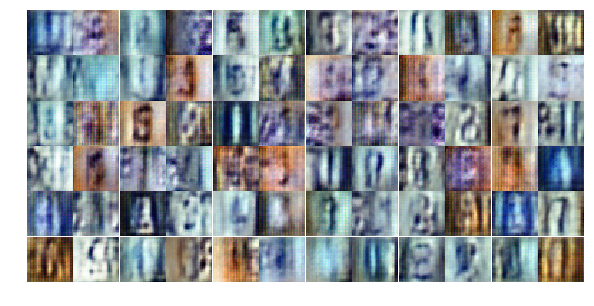

Epoch 4/20... Discriminator Loss: 1.2803... Generator Loss: 0.7055
Epoch 4/20... Discriminator Loss: 1.2352... Generator Loss: 0.9774
Epoch 4/20... Discriminator Loss: 1.1336... Generator Loss: 0.9040
Epoch 4/20... Discriminator Loss: 1.2943... Generator Loss: 0.9505
Epoch 4/20... Discriminator Loss: 1.1283... Generator Loss: 0.8912
Epoch 4/20... Discriminator Loss: 1.1981... Generator Loss: 1.0859
Epoch 4/20... Discriminator Loss: 1.2571... Generator Loss: 0.7752
Epoch 4/20... Discriminator Loss: 0.9968... Generator Loss: 1.1668
Epoch 4/20... Discriminator Loss: 1.0586... Generator Loss: 0.9955
Epoch 5/20... Discriminator Loss: 1.3534... Generator Loss: 0.6048


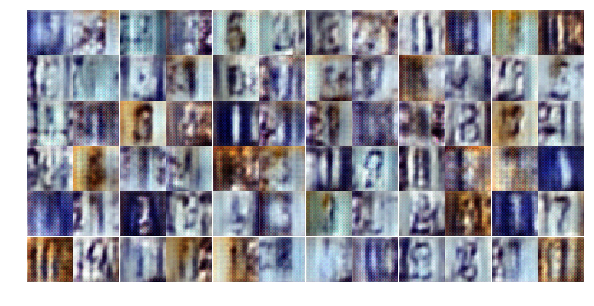

Epoch 5/20... Discriminator Loss: 1.2040... Generator Loss: 0.5595
Epoch 5/20... Discriminator Loss: 1.3346... Generator Loss: 1.2848
Epoch 5/20... Discriminator Loss: 1.2187... Generator Loss: 0.6998
Epoch 5/20... Discriminator Loss: 1.1175... Generator Loss: 0.6452
Epoch 5/20... Discriminator Loss: 1.1434... Generator Loss: 1.3018
Epoch 5/20... Discriminator Loss: 1.6019... Generator Loss: 0.4978
Epoch 5/20... Discriminator Loss: 1.2111... Generator Loss: 0.5879
Epoch 5/20... Discriminator Loss: 1.2248... Generator Loss: 0.8441
Epoch 5/20... Discriminator Loss: 0.9343... Generator Loss: 0.9225
Epoch 5/20... Discriminator Loss: 1.4877... Generator Loss: 0.6533


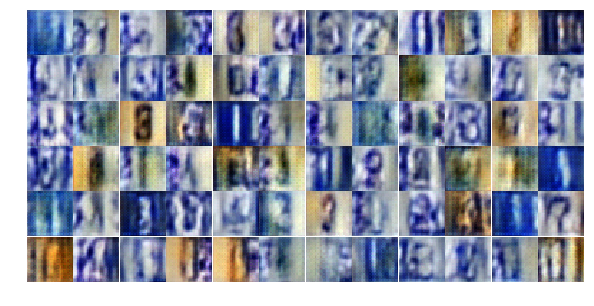

Epoch 5/20... Discriminator Loss: 1.1541... Generator Loss: 1.1133
Epoch 5/20... Discriminator Loss: 1.0471... Generator Loss: 0.9780
Epoch 5/20... Discriminator Loss: 1.3852... Generator Loss: 2.0806
Epoch 5/20... Discriminator Loss: 1.4801... Generator Loss: 0.5438
Epoch 5/20... Discriminator Loss: 1.2463... Generator Loss: 1.2070
Epoch 5/20... Discriminator Loss: 1.1967... Generator Loss: 0.6582
Epoch 5/20... Discriminator Loss: 1.0961... Generator Loss: 0.7977
Epoch 5/20... Discriminator Loss: 1.1446... Generator Loss: 0.8894
Epoch 5/20... Discriminator Loss: 1.1907... Generator Loss: 0.5529
Epoch 5/20... Discriminator Loss: 1.0115... Generator Loss: 0.8553


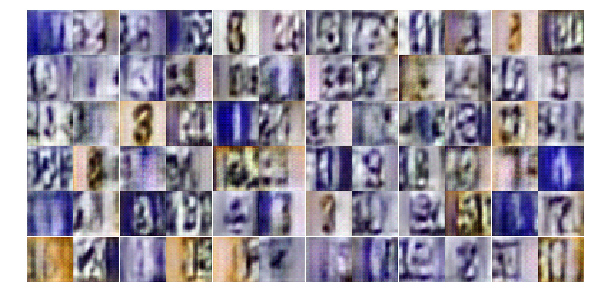

Epoch 5/20... Discriminator Loss: 1.0934... Generator Loss: 0.9734
Epoch 5/20... Discriminator Loss: 1.5480... Generator Loss: 0.3410
Epoch 5/20... Discriminator Loss: 1.4280... Generator Loss: 0.4842
Epoch 5/20... Discriminator Loss: 1.2877... Generator Loss: 1.3757
Epoch 5/20... Discriminator Loss: 1.2362... Generator Loss: 0.5711
Epoch 5/20... Discriminator Loss: 1.3428... Generator Loss: 0.5354
Epoch 5/20... Discriminator Loss: 1.1834... Generator Loss: 0.7375
Epoch 5/20... Discriminator Loss: 1.3026... Generator Loss: 0.5286
Epoch 5/20... Discriminator Loss: 1.1781... Generator Loss: 0.6821
Epoch 5/20... Discriminator Loss: 1.0492... Generator Loss: 1.6638


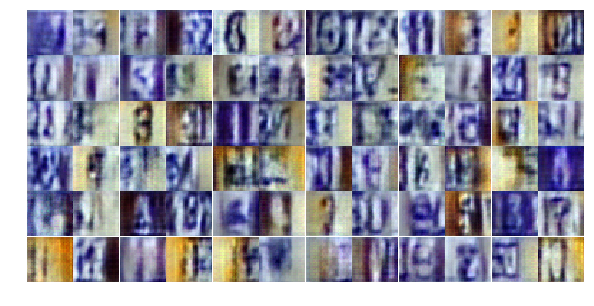

Epoch 5/20... Discriminator Loss: 1.2166... Generator Loss: 0.6603
Epoch 5/20... Discriminator Loss: 1.0397... Generator Loss: 1.1078
Epoch 5/20... Discriminator Loss: 1.2920... Generator Loss: 1.0477
Epoch 5/20... Discriminator Loss: 1.2052... Generator Loss: 0.6679
Epoch 5/20... Discriminator Loss: 0.9591... Generator Loss: 1.1047
Epoch 5/20... Discriminator Loss: 1.3491... Generator Loss: 1.3484
Epoch 5/20... Discriminator Loss: 1.4873... Generator Loss: 0.3651
Epoch 5/20... Discriminator Loss: 1.0337... Generator Loss: 1.1402
Epoch 5/20... Discriminator Loss: 1.2313... Generator Loss: 0.7276
Epoch 5/20... Discriminator Loss: 1.2885... Generator Loss: 0.6223


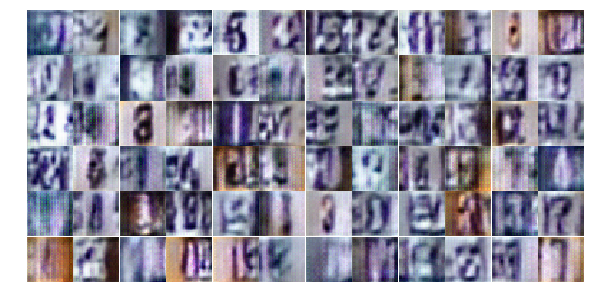

Epoch 5/20... Discriminator Loss: 1.0658... Generator Loss: 1.0132
Epoch 5/20... Discriminator Loss: 1.0340... Generator Loss: 0.8037
Epoch 5/20... Discriminator Loss: 1.3990... Generator Loss: 0.5158
Epoch 5/20... Discriminator Loss: 1.1922... Generator Loss: 1.2673
Epoch 5/20... Discriminator Loss: 1.1504... Generator Loss: 0.7786
Epoch 5/20... Discriminator Loss: 1.1732... Generator Loss: 0.9967
Epoch 5/20... Discriminator Loss: 1.3279... Generator Loss: 0.5957
Epoch 5/20... Discriminator Loss: 1.2163... Generator Loss: 0.8373
Epoch 5/20... Discriminator Loss: 1.0820... Generator Loss: 0.8057
Epoch 5/20... Discriminator Loss: 1.1806... Generator Loss: 0.9557


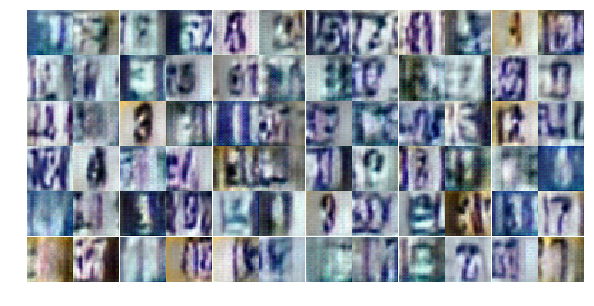

Epoch 5/20... Discriminator Loss: 1.3908... Generator Loss: 0.4842
Epoch 5/20... Discriminator Loss: 1.1436... Generator Loss: 0.7128
Epoch 5/20... Discriminator Loss: 1.1113... Generator Loss: 0.9673
Epoch 5/20... Discriminator Loss: 1.3419... Generator Loss: 0.5114
Epoch 5/20... Discriminator Loss: 1.2398... Generator Loss: 1.0288
Epoch 5/20... Discriminator Loss: 1.2501... Generator Loss: 0.7016
Epoch 6/20... Discriminator Loss: 1.1417... Generator Loss: 0.8230
Epoch 6/20... Discriminator Loss: 1.2308... Generator Loss: 0.6358
Epoch 6/20... Discriminator Loss: 0.9899... Generator Loss: 0.9152
Epoch 6/20... Discriminator Loss: 1.2029... Generator Loss: 0.9336


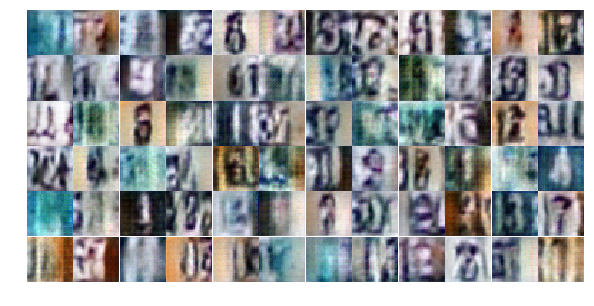

Epoch 6/20... Discriminator Loss: 1.3865... Generator Loss: 0.6287
Epoch 6/20... Discriminator Loss: 1.1998... Generator Loss: 0.8302
Epoch 6/20... Discriminator Loss: 1.3060... Generator Loss: 1.3192
Epoch 6/20... Discriminator Loss: 1.1967... Generator Loss: 0.7988
Epoch 6/20... Discriminator Loss: 1.3044... Generator Loss: 0.6340
Epoch 6/20... Discriminator Loss: 1.8912... Generator Loss: 0.2319
Epoch 6/20... Discriminator Loss: 1.3114... Generator Loss: 0.6472
Epoch 6/20... Discriminator Loss: 1.3032... Generator Loss: 0.5279
Epoch 6/20... Discriminator Loss: 1.0544... Generator Loss: 0.7879
Epoch 6/20... Discriminator Loss: 1.0756... Generator Loss: 0.7394


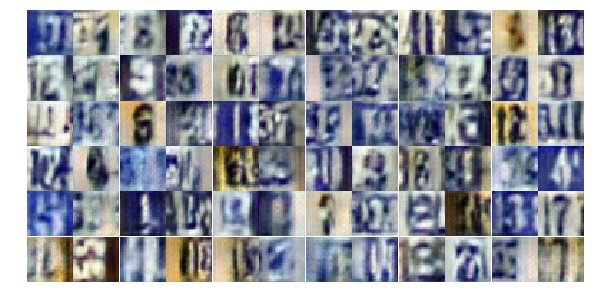

Epoch 6/20... Discriminator Loss: 1.4214... Generator Loss: 0.8625
Epoch 6/20... Discriminator Loss: 1.1440... Generator Loss: 0.5853
Epoch 6/20... Discriminator Loss: 1.4140... Generator Loss: 0.5397
Epoch 6/20... Discriminator Loss: 1.0984... Generator Loss: 0.7904
Epoch 6/20... Discriminator Loss: 1.1423... Generator Loss: 1.0600
Epoch 6/20... Discriminator Loss: 1.0834... Generator Loss: 1.1304
Epoch 6/20... Discriminator Loss: 0.9258... Generator Loss: 0.9845
Epoch 6/20... Discriminator Loss: 1.4239... Generator Loss: 0.4681
Epoch 6/20... Discriminator Loss: 1.0487... Generator Loss: 1.0110
Epoch 6/20... Discriminator Loss: 1.2433... Generator Loss: 0.7391


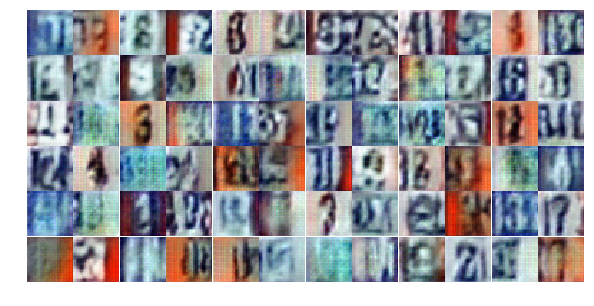

Epoch 6/20... Discriminator Loss: 1.3885... Generator Loss: 0.4678
Epoch 6/20... Discriminator Loss: 1.1645... Generator Loss: 1.0849
Epoch 6/20... Discriminator Loss: 1.2641... Generator Loss: 1.1774
Epoch 6/20... Discriminator Loss: 1.2607... Generator Loss: 0.7152
Epoch 6/20... Discriminator Loss: 1.0814... Generator Loss: 1.0137
Epoch 6/20... Discriminator Loss: 1.5742... Generator Loss: 0.3854
Epoch 6/20... Discriminator Loss: 1.0506... Generator Loss: 0.8098
Epoch 6/20... Discriminator Loss: 1.1230... Generator Loss: 0.8502
Epoch 6/20... Discriminator Loss: 1.1384... Generator Loss: 0.8003
Epoch 6/20... Discriminator Loss: 1.4522... Generator Loss: 0.8378


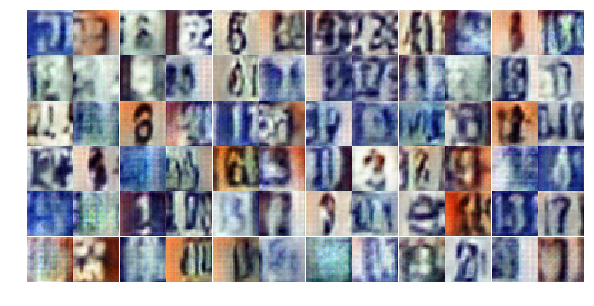

Epoch 6/20... Discriminator Loss: 1.2574... Generator Loss: 0.6312
Epoch 6/20... Discriminator Loss: 1.3712... Generator Loss: 0.8287
Epoch 6/20... Discriminator Loss: 1.1026... Generator Loss: 1.1733
Epoch 6/20... Discriminator Loss: 1.2766... Generator Loss: 0.5483
Epoch 6/20... Discriminator Loss: 1.3148... Generator Loss: 1.0225
Epoch 6/20... Discriminator Loss: 1.3079... Generator Loss: 0.5798
Epoch 6/20... Discriminator Loss: 1.3042... Generator Loss: 0.5822
Epoch 6/20... Discriminator Loss: 1.2459... Generator Loss: 1.3163
Epoch 6/20... Discriminator Loss: 1.2690... Generator Loss: 0.6072
Epoch 6/20... Discriminator Loss: 0.9983... Generator Loss: 0.9448


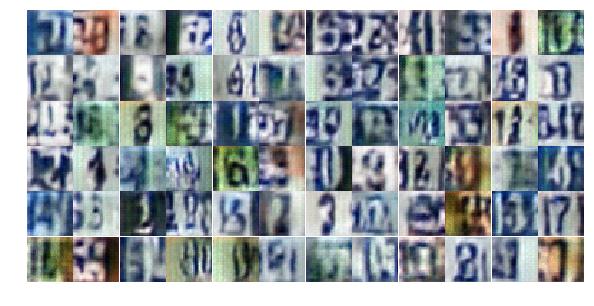

Epoch 6/20... Discriminator Loss: 1.2588... Generator Loss: 0.7960
Epoch 6/20... Discriminator Loss: 1.2821... Generator Loss: 0.8736
Epoch 6/20... Discriminator Loss: 1.2861... Generator Loss: 0.6978
Epoch 6/20... Discriminator Loss: 0.9466... Generator Loss: 1.2868
Epoch 6/20... Discriminator Loss: 1.1270... Generator Loss: 1.1951
Epoch 6/20... Discriminator Loss: 0.9958... Generator Loss: 0.9518
Epoch 6/20... Discriminator Loss: 1.1682... Generator Loss: 0.6921
Epoch 6/20... Discriminator Loss: 1.2486... Generator Loss: 0.5712
Epoch 6/20... Discriminator Loss: 1.1905... Generator Loss: 0.6433
Epoch 6/20... Discriminator Loss: 1.4823... Generator Loss: 0.3802


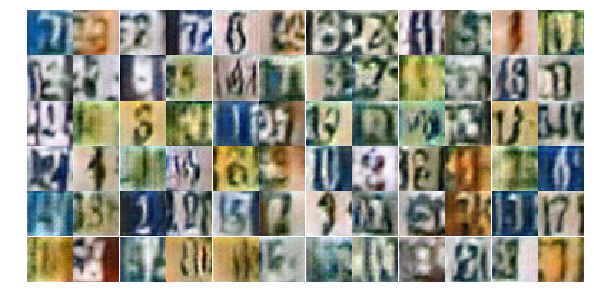

Epoch 6/20... Discriminator Loss: 1.1967... Generator Loss: 0.7356
Epoch 6/20... Discriminator Loss: 1.1715... Generator Loss: 1.0610
Epoch 6/20... Discriminator Loss: 1.0996... Generator Loss: 0.8916
Epoch 7/20... Discriminator Loss: 1.1904... Generator Loss: 0.6795
Epoch 7/20... Discriminator Loss: 1.2474... Generator Loss: 0.6043
Epoch 7/20... Discriminator Loss: 1.2222... Generator Loss: 0.7320
Epoch 7/20... Discriminator Loss: 1.2713... Generator Loss: 0.5909
Epoch 7/20... Discriminator Loss: 1.2184... Generator Loss: 0.6447
Epoch 7/20... Discriminator Loss: 1.0991... Generator Loss: 0.7288
Epoch 7/20... Discriminator Loss: 1.2855... Generator Loss: 0.5203


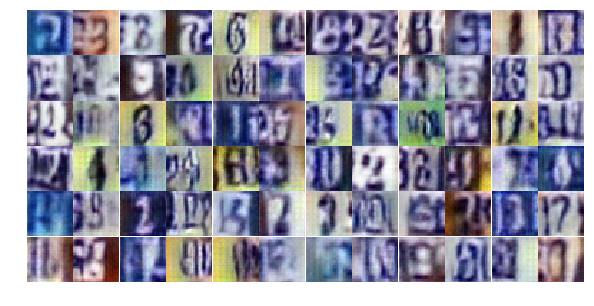

Epoch 7/20... Discriminator Loss: 1.0196... Generator Loss: 1.1975
Epoch 7/20... Discriminator Loss: 1.2560... Generator Loss: 0.5715
Epoch 7/20... Discriminator Loss: 1.3087... Generator Loss: 1.1772
Epoch 7/20... Discriminator Loss: 1.2428... Generator Loss: 1.0734
Epoch 7/20... Discriminator Loss: 1.2003... Generator Loss: 0.5925
Epoch 7/20... Discriminator Loss: 1.5321... Generator Loss: 0.5370
Epoch 7/20... Discriminator Loss: 1.2440... Generator Loss: 1.3255
Epoch 7/20... Discriminator Loss: 1.2549... Generator Loss: 1.1283
Epoch 7/20... Discriminator Loss: 1.2483... Generator Loss: 0.7788
Epoch 7/20... Discriminator Loss: 0.9448... Generator Loss: 0.9082


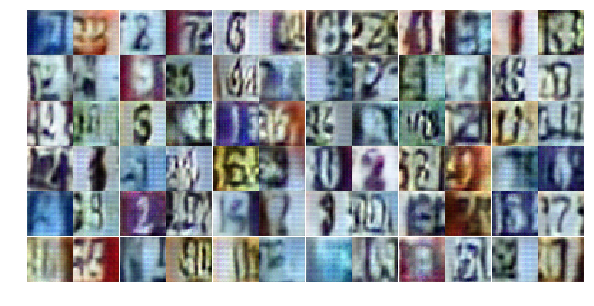

Epoch 7/20... Discriminator Loss: 1.1467... Generator Loss: 1.2575
Epoch 7/20... Discriminator Loss: 1.3727... Generator Loss: 0.4836
Epoch 7/20... Discriminator Loss: 1.5265... Generator Loss: 0.9031
Epoch 7/20... Discriminator Loss: 1.3395... Generator Loss: 0.5037
Epoch 7/20... Discriminator Loss: 1.1871... Generator Loss: 0.6448
Epoch 7/20... Discriminator Loss: 1.3252... Generator Loss: 1.0507
Epoch 7/20... Discriminator Loss: 1.0700... Generator Loss: 0.7067
Epoch 7/20... Discriminator Loss: 1.7139... Generator Loss: 0.3011
Epoch 7/20... Discriminator Loss: 1.1850... Generator Loss: 1.4413
Epoch 7/20... Discriminator Loss: 1.2477... Generator Loss: 0.8475


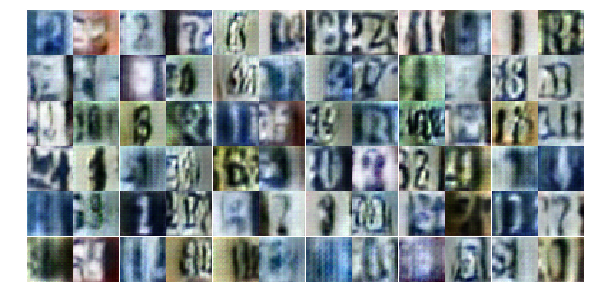

Epoch 7/20... Discriminator Loss: 1.1799... Generator Loss: 0.6831
Epoch 7/20... Discriminator Loss: 1.6474... Generator Loss: 0.3732
Epoch 7/20... Discriminator Loss: 1.1221... Generator Loss: 0.7398
Epoch 7/20... Discriminator Loss: 1.2763... Generator Loss: 0.5768
Epoch 7/20... Discriminator Loss: 1.0809... Generator Loss: 1.0037
Epoch 7/20... Discriminator Loss: 1.6165... Generator Loss: 0.3136
Epoch 7/20... Discriminator Loss: 1.2175... Generator Loss: 1.0336
Epoch 7/20... Discriminator Loss: 1.2608... Generator Loss: 0.6559
Epoch 7/20... Discriminator Loss: 1.3634... Generator Loss: 0.5583
Epoch 7/20... Discriminator Loss: 1.0965... Generator Loss: 1.2309


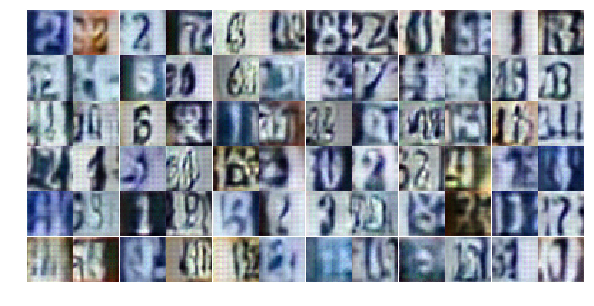

Epoch 7/20... Discriminator Loss: 1.1714... Generator Loss: 0.8996
Epoch 7/20... Discriminator Loss: 1.3636... Generator Loss: 0.5127
Epoch 7/20... Discriminator Loss: 1.0751... Generator Loss: 0.9581
Epoch 7/20... Discriminator Loss: 1.3122... Generator Loss: 0.6448
Epoch 7/20... Discriminator Loss: 1.0290... Generator Loss: 0.9924
Epoch 7/20... Discriminator Loss: 1.0640... Generator Loss: 1.2563
Epoch 7/20... Discriminator Loss: 1.1489... Generator Loss: 0.7092
Epoch 7/20... Discriminator Loss: 1.2342... Generator Loss: 0.7475
Epoch 7/20... Discriminator Loss: 1.0809... Generator Loss: 1.9127
Epoch 7/20... Discriminator Loss: 1.4836... Generator Loss: 0.4362


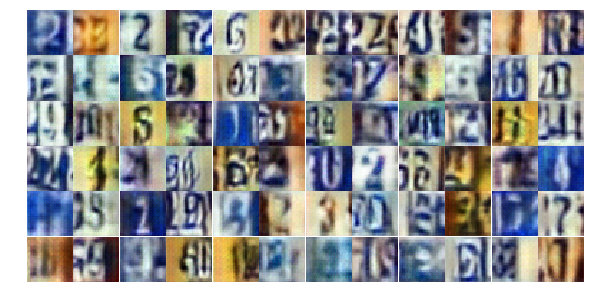

Epoch 7/20... Discriminator Loss: 0.9555... Generator Loss: 1.3014
Epoch 7/20... Discriminator Loss: 1.1482... Generator Loss: 0.6488
Epoch 7/20... Discriminator Loss: 1.1133... Generator Loss: 0.9217
Epoch 7/20... Discriminator Loss: 1.2755... Generator Loss: 0.8412
Epoch 7/20... Discriminator Loss: 1.2767... Generator Loss: 0.7578
Epoch 7/20... Discriminator Loss: 1.2627... Generator Loss: 0.5423
Epoch 7/20... Discriminator Loss: 1.2061... Generator Loss: 0.6206
Epoch 7/20... Discriminator Loss: 1.1413... Generator Loss: 1.1989
Epoch 7/20... Discriminator Loss: 1.0769... Generator Loss: 0.8373
Epoch 7/20... Discriminator Loss: 1.3111... Generator Loss: 0.5343


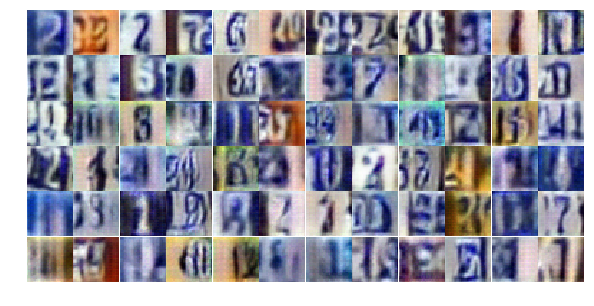

Epoch 7/20... Discriminator Loss: 1.2813... Generator Loss: 1.0308
Epoch 8/20... Discriminator Loss: 1.1912... Generator Loss: 0.6037
Epoch 8/20... Discriminator Loss: 1.1293... Generator Loss: 0.6925
Epoch 8/20... Discriminator Loss: 1.2890... Generator Loss: 0.5086
Epoch 8/20... Discriminator Loss: 1.0644... Generator Loss: 0.7269
Epoch 8/20... Discriminator Loss: 1.2423... Generator Loss: 0.6644
Epoch 8/20... Discriminator Loss: 1.4588... Generator Loss: 0.3946
Epoch 8/20... Discriminator Loss: 0.8887... Generator Loss: 1.0758
Epoch 8/20... Discriminator Loss: 1.2978... Generator Loss: 0.6674
Epoch 8/20... Discriminator Loss: 1.4409... Generator Loss: 0.3946


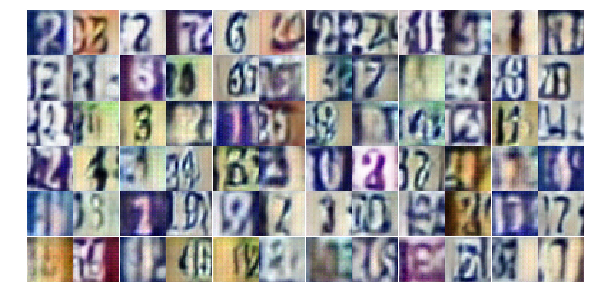

Epoch 8/20... Discriminator Loss: 1.1746... Generator Loss: 0.9510
Epoch 8/20... Discriminator Loss: 1.2365... Generator Loss: 0.6448
Epoch 8/20... Discriminator Loss: 1.2076... Generator Loss: 0.5827
Epoch 8/20... Discriminator Loss: 1.0608... Generator Loss: 1.3577
Epoch 8/20... Discriminator Loss: 1.2110... Generator Loss: 0.5580
Epoch 8/20... Discriminator Loss: 1.2447... Generator Loss: 1.5854
Epoch 8/20... Discriminator Loss: 1.2685... Generator Loss: 0.6201
Epoch 8/20... Discriminator Loss: 1.2697... Generator Loss: 0.7112
Epoch 8/20... Discriminator Loss: 1.1362... Generator Loss: 0.7906
Epoch 8/20... Discriminator Loss: 1.3296... Generator Loss: 0.7104


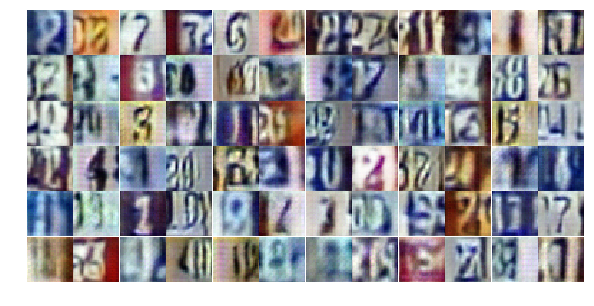

Epoch 8/20... Discriminator Loss: 1.1099... Generator Loss: 0.8477
Epoch 8/20... Discriminator Loss: 0.9587... Generator Loss: 0.9527
Epoch 8/20... Discriminator Loss: 1.1844... Generator Loss: 0.7516
Epoch 8/20... Discriminator Loss: 1.0976... Generator Loss: 1.3840
Epoch 8/20... Discriminator Loss: 1.0212... Generator Loss: 1.2172
Epoch 8/20... Discriminator Loss: 0.9880... Generator Loss: 0.9814
Epoch 8/20... Discriminator Loss: 1.2335... Generator Loss: 1.0143
Epoch 8/20... Discriminator Loss: 1.0277... Generator Loss: 1.1661
Epoch 8/20... Discriminator Loss: 1.1565... Generator Loss: 0.9740
Epoch 8/20... Discriminator Loss: 1.0821... Generator Loss: 0.7491


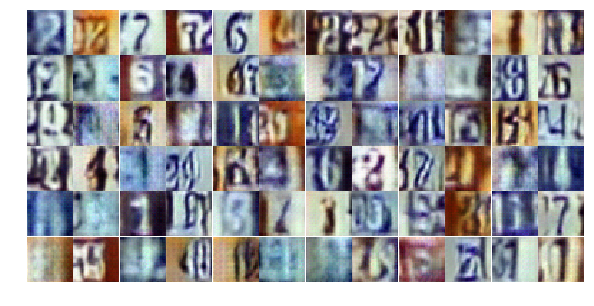

Epoch 8/20... Discriminator Loss: 1.1264... Generator Loss: 0.9973
Epoch 8/20... Discriminator Loss: 1.2798... Generator Loss: 0.4839
Epoch 8/20... Discriminator Loss: 1.2214... Generator Loss: 0.6075
Epoch 8/20... Discriminator Loss: 1.1825... Generator Loss: 0.6848
Epoch 8/20... Discriminator Loss: 1.1753... Generator Loss: 0.6561
Epoch 8/20... Discriminator Loss: 0.9144... Generator Loss: 1.1645
Epoch 8/20... Discriminator Loss: 0.6808... Generator Loss: 1.1135
Epoch 8/20... Discriminator Loss: 1.1522... Generator Loss: 0.7221
Epoch 8/20... Discriminator Loss: 1.2844... Generator Loss: 0.5172
Epoch 8/20... Discriminator Loss: 0.9939... Generator Loss: 0.8744


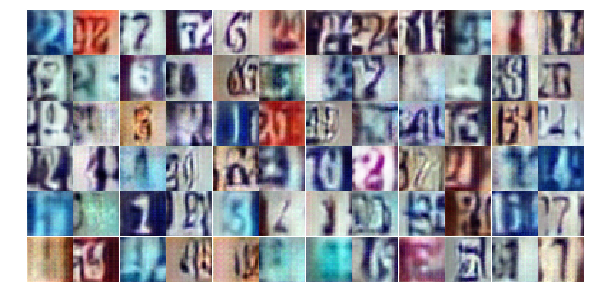

Epoch 8/20... Discriminator Loss: 1.0684... Generator Loss: 1.4826
Epoch 8/20... Discriminator Loss: 1.3158... Generator Loss: 0.4925
Epoch 8/20... Discriminator Loss: 1.1375... Generator Loss: 0.7143
Epoch 8/20... Discriminator Loss: 1.3418... Generator Loss: 1.2015
Epoch 8/20... Discriminator Loss: 1.3182... Generator Loss: 1.0210
Epoch 8/20... Discriminator Loss: 1.5332... Generator Loss: 0.3636
Epoch 8/20... Discriminator Loss: 1.0153... Generator Loss: 0.7935
Epoch 8/20... Discriminator Loss: 1.4582... Generator Loss: 0.4157
Epoch 8/20... Discriminator Loss: 1.2429... Generator Loss: 0.5615
Epoch 8/20... Discriminator Loss: 1.0865... Generator Loss: 1.3972


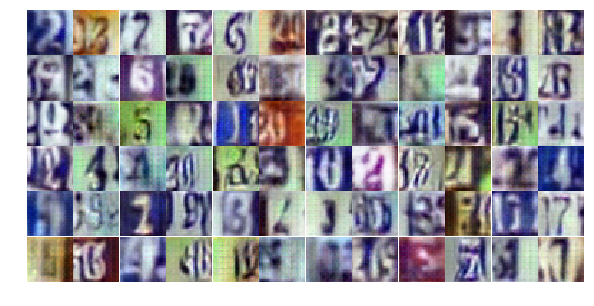

Epoch 8/20... Discriminator Loss: 1.5443... Generator Loss: 1.1112
Epoch 8/20... Discriminator Loss: 1.0501... Generator Loss: 1.0551
Epoch 8/20... Discriminator Loss: 1.3386... Generator Loss: 0.6280
Epoch 8/20... Discriminator Loss: 1.1794... Generator Loss: 0.6331
Epoch 8/20... Discriminator Loss: 1.0517... Generator Loss: 1.1271
Epoch 8/20... Discriminator Loss: 1.3089... Generator Loss: 0.8105
Epoch 8/20... Discriminator Loss: 1.1623... Generator Loss: 1.4094
Epoch 8/20... Discriminator Loss: 1.0799... Generator Loss: 0.9810
Epoch 9/20... Discriminator Loss: 1.3053... Generator Loss: 0.5981
Epoch 9/20... Discriminator Loss: 1.3008... Generator Loss: 0.5266


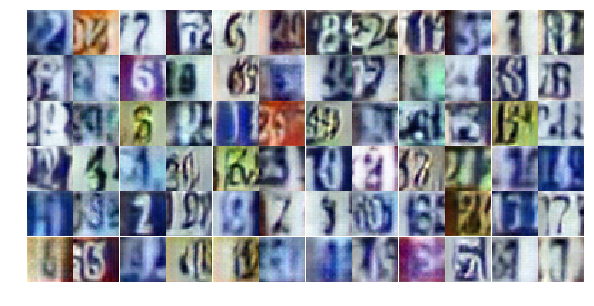

Epoch 9/20... Discriminator Loss: 1.2771... Generator Loss: 0.5903
Epoch 9/20... Discriminator Loss: 1.2527... Generator Loss: 1.1374
Epoch 9/20... Discriminator Loss: 1.2591... Generator Loss: 0.7276
Epoch 9/20... Discriminator Loss: 0.7547... Generator Loss: 1.5115
Epoch 9/20... Discriminator Loss: 1.4400... Generator Loss: 0.3592
Epoch 9/20... Discriminator Loss: 1.0112... Generator Loss: 0.8478
Epoch 9/20... Discriminator Loss: 1.1269... Generator Loss: 1.3046
Epoch 9/20... Discriminator Loss: 1.1861... Generator Loss: 0.7578
Epoch 9/20... Discriminator Loss: 1.5094... Generator Loss: 0.3530
Epoch 9/20... Discriminator Loss: 0.7276... Generator Loss: 1.1405


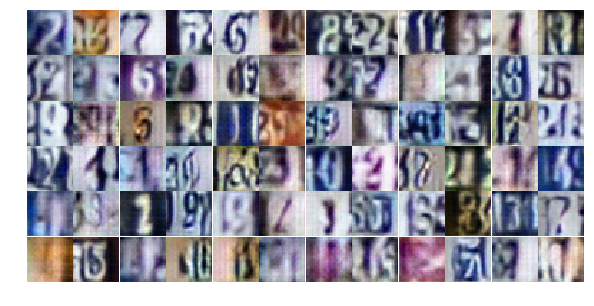

Epoch 9/20... Discriminator Loss: 1.0984... Generator Loss: 1.0211
Epoch 9/20... Discriminator Loss: 1.4101... Generator Loss: 0.3871
Epoch 9/20... Discriminator Loss: 1.3871... Generator Loss: 0.3908
Epoch 9/20... Discriminator Loss: 1.0794... Generator Loss: 0.6281
Epoch 9/20... Discriminator Loss: 1.0598... Generator Loss: 0.9093
Epoch 9/20... Discriminator Loss: 1.0643... Generator Loss: 0.6478
Epoch 9/20... Discriminator Loss: 1.2589... Generator Loss: 0.5311
Epoch 9/20... Discriminator Loss: 1.1830... Generator Loss: 0.5784
Epoch 9/20... Discriminator Loss: 1.6625... Generator Loss: 0.2876
Epoch 9/20... Discriminator Loss: 1.6846... Generator Loss: 0.3124


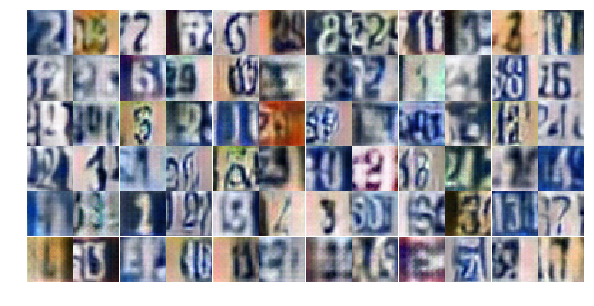

Epoch 9/20... Discriminator Loss: 1.2608... Generator Loss: 0.5785
Epoch 9/20... Discriminator Loss: 1.2834... Generator Loss: 1.0733
Epoch 9/20... Discriminator Loss: 1.0391... Generator Loss: 0.7464
Epoch 9/20... Discriminator Loss: 1.1773... Generator Loss: 0.5819
Epoch 9/20... Discriminator Loss: 0.9658... Generator Loss: 0.8715
Epoch 9/20... Discriminator Loss: 1.0762... Generator Loss: 0.9969
Epoch 9/20... Discriminator Loss: 1.1737... Generator Loss: 0.9176
Epoch 9/20... Discriminator Loss: 1.0290... Generator Loss: 0.7929
Epoch 9/20... Discriminator Loss: 1.0167... Generator Loss: 0.9066
Epoch 9/20... Discriminator Loss: 1.3950... Generator Loss: 0.3746


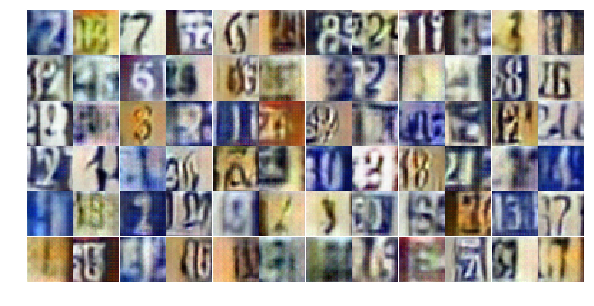

Epoch 9/20... Discriminator Loss: 0.9258... Generator Loss: 0.9738
Epoch 9/20... Discriminator Loss: 1.0551... Generator Loss: 1.5209
Epoch 9/20... Discriminator Loss: 1.2578... Generator Loss: 0.5150
Epoch 9/20... Discriminator Loss: 1.4103... Generator Loss: 0.5796
Epoch 9/20... Discriminator Loss: 1.1884... Generator Loss: 0.6321
Epoch 9/20... Discriminator Loss: 1.1210... Generator Loss: 0.6618
Epoch 9/20... Discriminator Loss: 1.0848... Generator Loss: 0.6611
Epoch 9/20... Discriminator Loss: 0.8785... Generator Loss: 1.0124
Epoch 9/20... Discriminator Loss: 1.2150... Generator Loss: 0.6697
Epoch 9/20... Discriminator Loss: 1.4197... Generator Loss: 0.6338


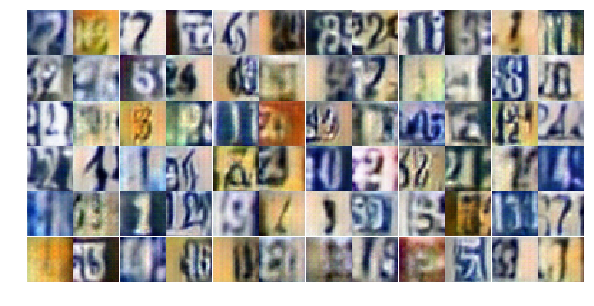

Epoch 9/20... Discriminator Loss: 0.9625... Generator Loss: 1.0282
Epoch 9/20... Discriminator Loss: 1.1354... Generator Loss: 0.5549
Epoch 9/20... Discriminator Loss: 1.2435... Generator Loss: 1.5148
Epoch 9/20... Discriminator Loss: 1.1438... Generator Loss: 1.3453
Epoch 9/20... Discriminator Loss: 1.0637... Generator Loss: 1.6544
Epoch 9/20... Discriminator Loss: 1.1213... Generator Loss: 0.6963
Epoch 9/20... Discriminator Loss: 1.2698... Generator Loss: 0.5046
Epoch 9/20... Discriminator Loss: 1.3072... Generator Loss: 0.4621
Epoch 9/20... Discriminator Loss: 1.0251... Generator Loss: 0.9554
Epoch 9/20... Discriminator Loss: 0.7972... Generator Loss: 1.1834


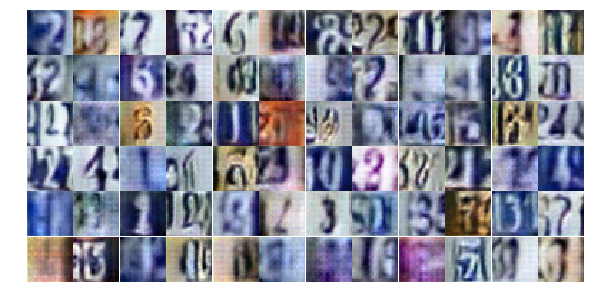

Epoch 9/20... Discriminator Loss: 1.4553... Generator Loss: 0.4046
Epoch 9/20... Discriminator Loss: 1.3591... Generator Loss: 2.6205
Epoch 9/20... Discriminator Loss: 1.2295... Generator Loss: 0.5316
Epoch 9/20... Discriminator Loss: 1.9279... Generator Loss: 0.2222
Epoch 9/20... Discriminator Loss: 1.0191... Generator Loss: 0.5722
Epoch 10/20... Discriminator Loss: 1.0670... Generator Loss: 0.6716
Epoch 10/20... Discriminator Loss: 1.1170... Generator Loss: 1.8320
Epoch 10/20... Discriminator Loss: 1.3688... Generator Loss: 0.3717
Epoch 10/20... Discriminator Loss: 1.1114... Generator Loss: 1.4876
Epoch 10/20... Discriminator Loss: 1.3386... Generator Loss: 0.5658


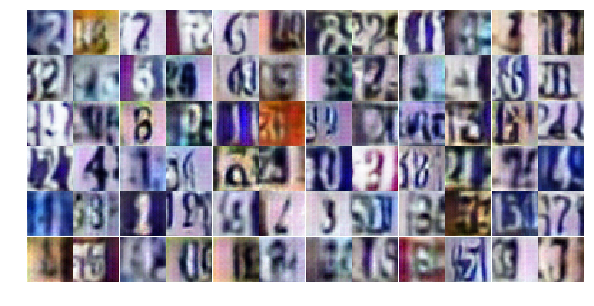

Epoch 10/20... Discriminator Loss: 1.0775... Generator Loss: 0.6363
Epoch 10/20... Discriminator Loss: 0.8877... Generator Loss: 0.8923
Epoch 10/20... Discriminator Loss: 0.9451... Generator Loss: 0.8705
Epoch 10/20... Discriminator Loss: 0.9702... Generator Loss: 0.7019
Epoch 10/20... Discriminator Loss: 1.1652... Generator Loss: 1.8435
Epoch 10/20... Discriminator Loss: 0.8839... Generator Loss: 1.1106
Epoch 10/20... Discriminator Loss: 0.9568... Generator Loss: 1.2292
Epoch 10/20... Discriminator Loss: 0.9479... Generator Loss: 1.2817
Epoch 10/20... Discriminator Loss: 0.6246... Generator Loss: 1.3859
Epoch 10/20... Discriminator Loss: 1.3210... Generator Loss: 0.4372


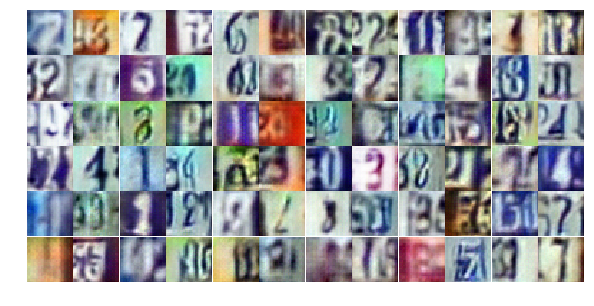

Epoch 10/20... Discriminator Loss: 0.9353... Generator Loss: 1.1675
Epoch 10/20... Discriminator Loss: 0.8781... Generator Loss: 1.4021
Epoch 10/20... Discriminator Loss: 0.9279... Generator Loss: 0.9632
Epoch 10/20... Discriminator Loss: 1.5321... Generator Loss: 0.3424
Epoch 10/20... Discriminator Loss: 0.8389... Generator Loss: 1.2667
Epoch 10/20... Discriminator Loss: 1.0464... Generator Loss: 0.7903
Epoch 10/20... Discriminator Loss: 0.9739... Generator Loss: 0.7655
Epoch 10/20... Discriminator Loss: 1.2957... Generator Loss: 0.4857
Epoch 10/20... Discriminator Loss: 0.8361... Generator Loss: 0.8609
Epoch 10/20... Discriminator Loss: 0.8451... Generator Loss: 1.9403


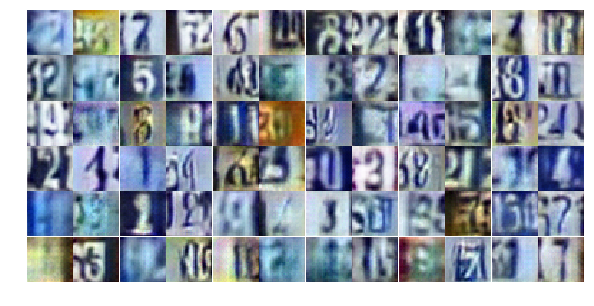

Epoch 10/20... Discriminator Loss: 0.7634... Generator Loss: 0.9560
Epoch 10/20... Discriminator Loss: 1.6650... Generator Loss: 0.2922
Epoch 10/20... Discriminator Loss: 0.6324... Generator Loss: 1.4578
Epoch 10/20... Discriminator Loss: 0.8395... Generator Loss: 1.7206
Epoch 10/20... Discriminator Loss: 1.5396... Generator Loss: 0.3635
Epoch 10/20... Discriminator Loss: 0.8070... Generator Loss: 1.2142
Epoch 10/20... Discriminator Loss: 0.9131... Generator Loss: 0.7878
Epoch 10/20... Discriminator Loss: 0.9721... Generator Loss: 1.4320
Epoch 10/20... Discriminator Loss: 1.1307... Generator Loss: 0.5770
Epoch 10/20... Discriminator Loss: 0.9506... Generator Loss: 1.3666


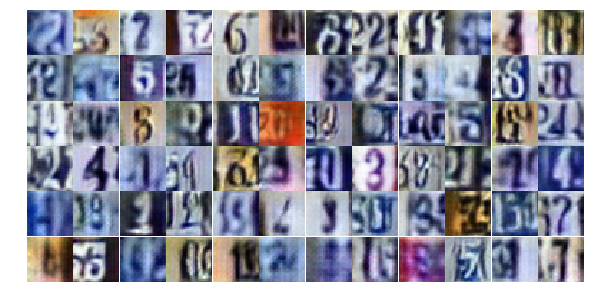

Epoch 10/20... Discriminator Loss: 0.9134... Generator Loss: 0.9588
Epoch 10/20... Discriminator Loss: 1.1193... Generator Loss: 0.6542
Epoch 10/20... Discriminator Loss: 1.2507... Generator Loss: 0.5420
Epoch 10/20... Discriminator Loss: 0.8555... Generator Loss: 1.0485
Epoch 10/20... Discriminator Loss: 1.1351... Generator Loss: 1.0092
Epoch 10/20... Discriminator Loss: 0.8923... Generator Loss: 0.9344
Epoch 10/20... Discriminator Loss: 1.2204... Generator Loss: 0.5196
Epoch 10/20... Discriminator Loss: 1.8452... Generator Loss: 0.2321
Epoch 10/20... Discriminator Loss: 0.8597... Generator Loss: 1.0355
Epoch 10/20... Discriminator Loss: 1.4093... Generator Loss: 0.3970


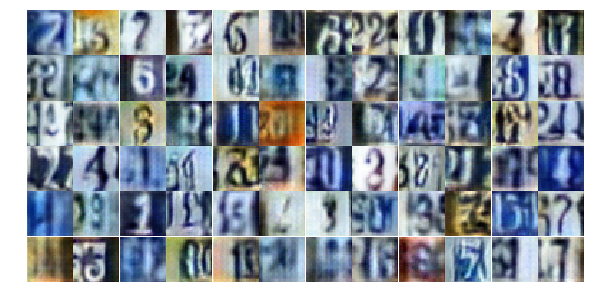

Epoch 10/20... Discriminator Loss: 0.9634... Generator Loss: 0.9035
Epoch 10/20... Discriminator Loss: 1.3996... Generator Loss: 1.1956
Epoch 10/20... Discriminator Loss: 1.6427... Generator Loss: 0.3287
Epoch 10/20... Discriminator Loss: 0.6072... Generator Loss: 1.8951
Epoch 10/20... Discriminator Loss: 0.8241... Generator Loss: 1.9149
Epoch 10/20... Discriminator Loss: 1.0776... Generator Loss: 0.7736
Epoch 10/20... Discriminator Loss: 1.1298... Generator Loss: 0.9259
Epoch 10/20... Discriminator Loss: 0.9971... Generator Loss: 0.6606
Epoch 10/20... Discriminator Loss: 0.7731... Generator Loss: 1.4702
Epoch 10/20... Discriminator Loss: 0.8610... Generator Loss: 1.0190


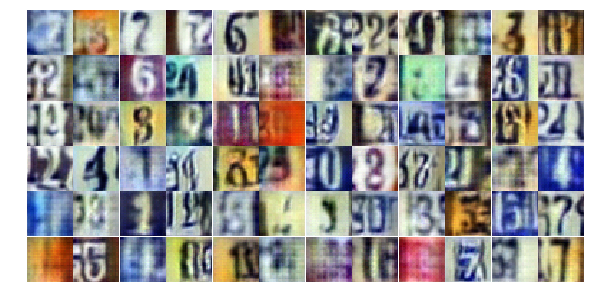

Epoch 10/20... Discriminator Loss: 1.7913... Generator Loss: 0.2727
Epoch 10/20... Discriminator Loss: 0.8173... Generator Loss: 0.8530
Epoch 10/20... Discriminator Loss: 1.1568... Generator Loss: 0.5474
Epoch 11/20... Discriminator Loss: 1.6034... Generator Loss: 0.2991
Epoch 11/20... Discriminator Loss: 0.6122... Generator Loss: 1.4183
Epoch 11/20... Discriminator Loss: 1.4295... Generator Loss: 0.4258
Epoch 11/20... Discriminator Loss: 0.9529... Generator Loss: 0.9414
Epoch 11/20... Discriminator Loss: 1.6366... Generator Loss: 1.7981
Epoch 11/20... Discriminator Loss: 1.2631... Generator Loss: 0.5313
Epoch 11/20... Discriminator Loss: 0.6899... Generator Loss: 1.2885


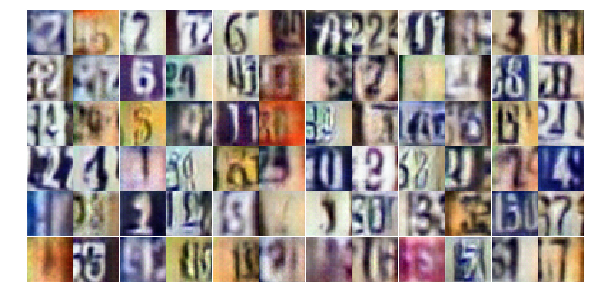

Epoch 11/20... Discriminator Loss: 0.5085... Generator Loss: 1.6353
Epoch 11/20... Discriminator Loss: 1.2092... Generator Loss: 0.6084
Epoch 11/20... Discriminator Loss: 1.1378... Generator Loss: 0.5732
Epoch 11/20... Discriminator Loss: 1.5690... Generator Loss: 0.3501
Epoch 11/20... Discriminator Loss: 1.0572... Generator Loss: 1.0282
Epoch 11/20... Discriminator Loss: 1.0752... Generator Loss: 0.6669
Epoch 11/20... Discriminator Loss: 0.7114... Generator Loss: 1.9305
Epoch 11/20... Discriminator Loss: 0.7444... Generator Loss: 1.1212
Epoch 11/20... Discriminator Loss: 1.1684... Generator Loss: 0.6082
Epoch 11/20... Discriminator Loss: 1.3630... Generator Loss: 0.5732


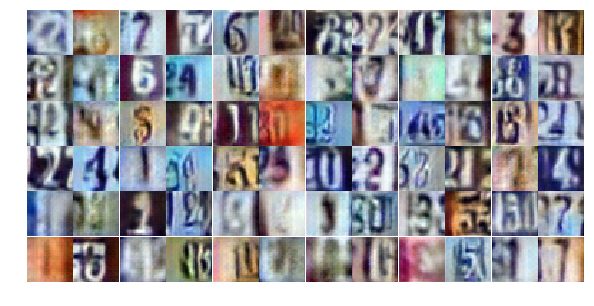

Epoch 11/20... Discriminator Loss: 1.0840... Generator Loss: 0.6157
Epoch 11/20... Discriminator Loss: 0.7256... Generator Loss: 1.4830
Epoch 11/20... Discriminator Loss: 0.7490... Generator Loss: 0.9246
Epoch 11/20... Discriminator Loss: 0.4669... Generator Loss: 1.8526
Epoch 11/20... Discriminator Loss: 0.8744... Generator Loss: 1.4415
Epoch 11/20... Discriminator Loss: 1.1225... Generator Loss: 0.5606
Epoch 11/20... Discriminator Loss: 1.1617... Generator Loss: 0.5525
Epoch 11/20... Discriminator Loss: 0.6642... Generator Loss: 1.5747
Epoch 11/20... Discriminator Loss: 0.9853... Generator Loss: 0.9138
Epoch 11/20... Discriminator Loss: 0.9834... Generator Loss: 0.6544


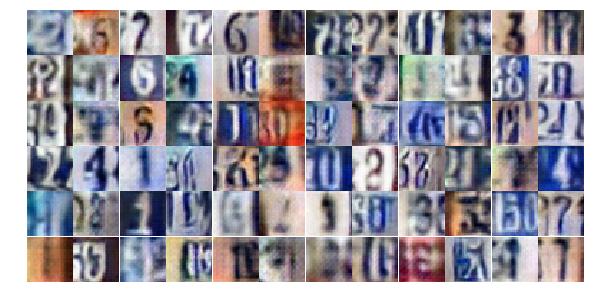

Epoch 11/20... Discriminator Loss: 1.5486... Generator Loss: 0.3496
Epoch 11/20... Discriminator Loss: 1.0703... Generator Loss: 1.0641
Epoch 11/20... Discriminator Loss: 0.8334... Generator Loss: 0.8613
Epoch 11/20... Discriminator Loss: 0.8142... Generator Loss: 0.9458
Epoch 11/20... Discriminator Loss: 0.9281... Generator Loss: 0.9473
Epoch 11/20... Discriminator Loss: 1.0051... Generator Loss: 2.6216
Epoch 11/20... Discriminator Loss: 1.1892... Generator Loss: 0.5539
Epoch 11/20... Discriminator Loss: 1.2070... Generator Loss: 0.5517
Epoch 11/20... Discriminator Loss: 0.9028... Generator Loss: 0.9754
Epoch 11/20... Discriminator Loss: 1.0031... Generator Loss: 0.6844


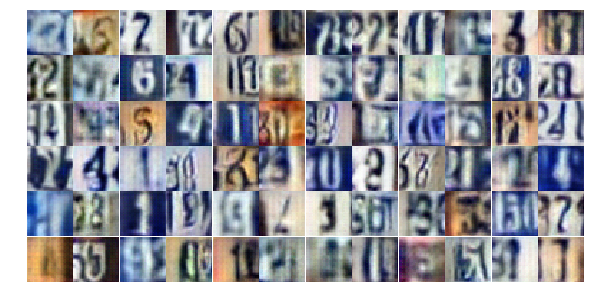

Epoch 11/20... Discriminator Loss: 0.9813... Generator Loss: 0.8303
Epoch 11/20... Discriminator Loss: 1.1182... Generator Loss: 0.5605
Epoch 11/20... Discriminator Loss: 0.8748... Generator Loss: 1.0214
Epoch 11/20... Discriminator Loss: 1.2406... Generator Loss: 0.9315
Epoch 11/20... Discriminator Loss: 0.9470... Generator Loss: 0.7922
Epoch 11/20... Discriminator Loss: 0.6519... Generator Loss: 1.2707
Epoch 11/20... Discriminator Loss: 0.6564... Generator Loss: 1.1201
Epoch 11/20... Discriminator Loss: 0.9411... Generator Loss: 0.6712
Epoch 11/20... Discriminator Loss: 1.4971... Generator Loss: 0.3514
Epoch 11/20... Discriminator Loss: 0.8803... Generator Loss: 1.7196


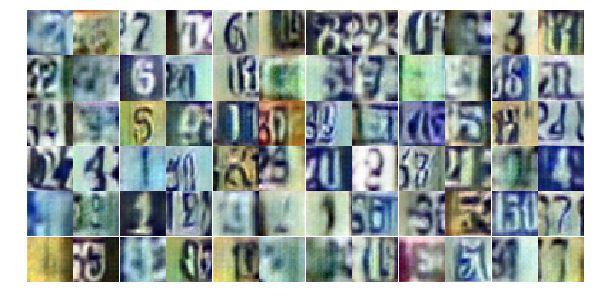

Epoch 11/20... Discriminator Loss: 1.0415... Generator Loss: 1.2233
Epoch 11/20... Discriminator Loss: 1.2893... Generator Loss: 0.4616
Epoch 11/20... Discriminator Loss: 0.9774... Generator Loss: 0.8686
Epoch 11/20... Discriminator Loss: 1.1538... Generator Loss: 0.6215
Epoch 11/20... Discriminator Loss: 1.0665... Generator Loss: 0.6390
Epoch 11/20... Discriminator Loss: 1.1294... Generator Loss: 0.5926
Epoch 11/20... Discriminator Loss: 0.9143... Generator Loss: 0.8481
Epoch 11/20... Discriminator Loss: 0.9060... Generator Loss: 1.5554
Epoch 11/20... Discriminator Loss: 1.2958... Generator Loss: 0.5319
Epoch 11/20... Discriminator Loss: 0.9270... Generator Loss: 0.8178


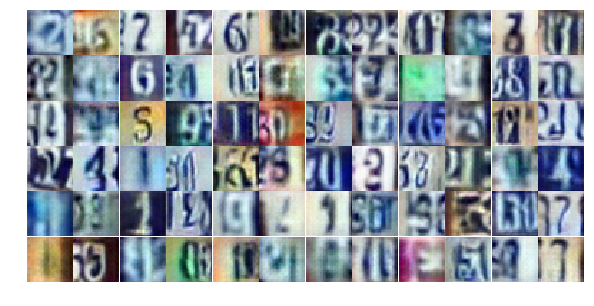

Epoch 12/20... Discriminator Loss: 1.7757... Generator Loss: 0.3645
Epoch 12/20... Discriminator Loss: 0.7266... Generator Loss: 1.4853
Epoch 12/20... Discriminator Loss: 0.9454... Generator Loss: 1.1511
Epoch 12/20... Discriminator Loss: 0.6322... Generator Loss: 1.5028
Epoch 12/20... Discriminator Loss: 0.5983... Generator Loss: 1.7083
Epoch 12/20... Discriminator Loss: 1.0514... Generator Loss: 0.6852
Epoch 12/20... Discriminator Loss: 0.9576... Generator Loss: 0.8601
Epoch 12/20... Discriminator Loss: 1.1257... Generator Loss: 0.8144
Epoch 12/20... Discriminator Loss: 0.8812... Generator Loss: 1.0932
Epoch 12/20... Discriminator Loss: 1.1492... Generator Loss: 0.6857


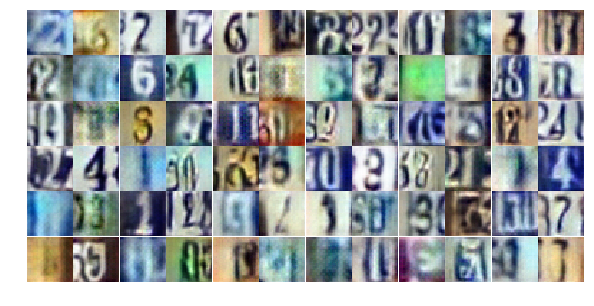

Epoch 12/20... Discriminator Loss: 0.4856... Generator Loss: 1.8038
Epoch 12/20... Discriminator Loss: 0.8437... Generator Loss: 0.8411
Epoch 12/20... Discriminator Loss: 1.0026... Generator Loss: 0.6244
Epoch 12/20... Discriminator Loss: 1.0455... Generator Loss: 2.2266
Epoch 12/20... Discriminator Loss: 0.4133... Generator Loss: 1.7489
Epoch 12/20... Discriminator Loss: 1.6163... Generator Loss: 0.9435
Epoch 12/20... Discriminator Loss: 1.6398... Generator Loss: 0.3370
Epoch 12/20... Discriminator Loss: 0.6371... Generator Loss: 1.3349
Epoch 12/20... Discriminator Loss: 0.8871... Generator Loss: 0.9395
Epoch 12/20... Discriminator Loss: 1.2645... Generator Loss: 0.5216


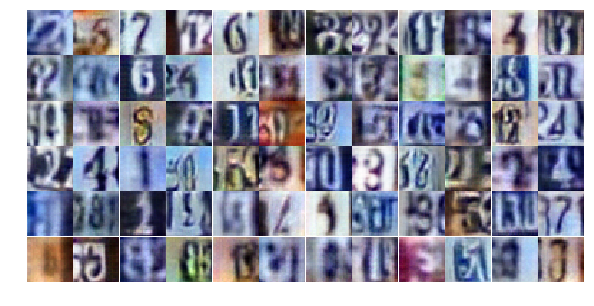

Epoch 12/20... Discriminator Loss: 0.7152... Generator Loss: 1.9496
Epoch 12/20... Discriminator Loss: 0.6355... Generator Loss: 1.3850
Epoch 12/20... Discriminator Loss: 0.9766... Generator Loss: 0.7802
Epoch 12/20... Discriminator Loss: 1.0022... Generator Loss: 0.9826
Epoch 12/20... Discriminator Loss: 0.5294... Generator Loss: 1.4052
Epoch 12/20... Discriminator Loss: 0.3291... Generator Loss: 1.7550
Epoch 12/20... Discriminator Loss: 0.9251... Generator Loss: 1.9551
Epoch 12/20... Discriminator Loss: 0.7110... Generator Loss: 1.0492
Epoch 12/20... Discriminator Loss: 0.8097... Generator Loss: 0.8900
Epoch 12/20... Discriminator Loss: 0.9320... Generator Loss: 1.0892


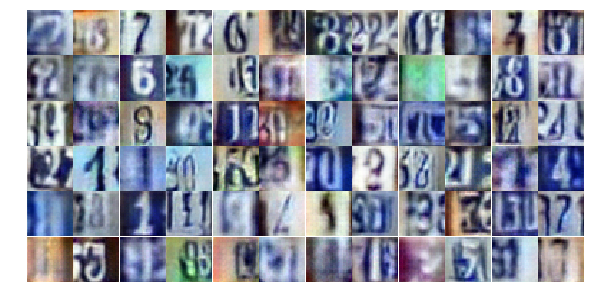

Epoch 12/20... Discriminator Loss: 0.5448... Generator Loss: 1.4938
Epoch 12/20... Discriminator Loss: 1.0763... Generator Loss: 1.5114
Epoch 12/20... Discriminator Loss: 0.6209... Generator Loss: 1.7743
Epoch 12/20... Discriminator Loss: 1.8811... Generator Loss: 0.4979
Epoch 12/20... Discriminator Loss: 1.4480... Generator Loss: 1.8819
Epoch 12/20... Discriminator Loss: 1.4642... Generator Loss: 0.4672
Epoch 12/20... Discriminator Loss: 0.8446... Generator Loss: 0.9482
Epoch 12/20... Discriminator Loss: 0.8736... Generator Loss: 1.4622
Epoch 12/20... Discriminator Loss: 1.1883... Generator Loss: 0.5564
Epoch 12/20... Discriminator Loss: 1.0142... Generator Loss: 1.9401


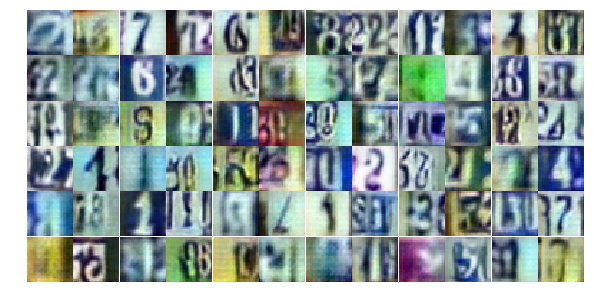

Epoch 12/20... Discriminator Loss: 0.7485... Generator Loss: 1.0936
Epoch 12/20... Discriminator Loss: 0.7861... Generator Loss: 1.4686
Epoch 12/20... Discriminator Loss: 0.4119... Generator Loss: 1.8732
Epoch 12/20... Discriminator Loss: 1.2077... Generator Loss: 0.5644
Epoch 12/20... Discriminator Loss: 0.7486... Generator Loss: 1.0510
Epoch 12/20... Discriminator Loss: 1.2034... Generator Loss: 0.5972
Epoch 12/20... Discriminator Loss: 1.1305... Generator Loss: 0.5694
Epoch 12/20... Discriminator Loss: 1.2106... Generator Loss: 0.8876
Epoch 12/20... Discriminator Loss: 0.7413... Generator Loss: 1.0331
Epoch 12/20... Discriminator Loss: 0.8184... Generator Loss: 1.0295


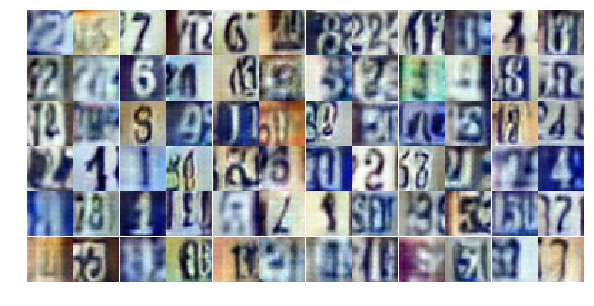

Epoch 12/20... Discriminator Loss: 1.1353... Generator Loss: 0.5729
Epoch 12/20... Discriminator Loss: 0.9645... Generator Loss: 1.5783
Epoch 12/20... Discriminator Loss: 1.1386... Generator Loss: 0.9437
Epoch 12/20... Discriminator Loss: 1.2411... Generator Loss: 0.7201
Epoch 12/20... Discriminator Loss: 0.7820... Generator Loss: 0.9337
Epoch 12/20... Discriminator Loss: 1.1024... Generator Loss: 1.4517
Epoch 12/20... Discriminator Loss: 0.9576... Generator Loss: 0.9082
Epoch 13/20... Discriminator Loss: 0.9818... Generator Loss: 0.8945
Epoch 13/20... Discriminator Loss: 0.8600... Generator Loss: 0.8569
Epoch 13/20... Discriminator Loss: 0.8343... Generator Loss: 1.3156


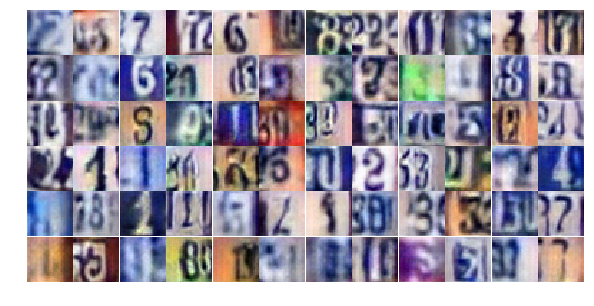

Epoch 13/20... Discriminator Loss: 0.3105... Generator Loss: 2.2698
Epoch 13/20... Discriminator Loss: 0.8724... Generator Loss: 1.1430
Epoch 13/20... Discriminator Loss: 1.3242... Generator Loss: 0.8052
Epoch 13/20... Discriminator Loss: 1.3795... Generator Loss: 0.7704
Epoch 13/20... Discriminator Loss: 0.5919... Generator Loss: 1.7832
Epoch 13/20... Discriminator Loss: 0.6671... Generator Loss: 1.0548
Epoch 13/20... Discriminator Loss: 0.6134... Generator Loss: 1.6460
Epoch 13/20... Discriminator Loss: 1.2719... Generator Loss: 0.4613
Epoch 13/20... Discriminator Loss: 1.0833... Generator Loss: 0.5688
Epoch 13/20... Discriminator Loss: 0.8883... Generator Loss: 1.0241


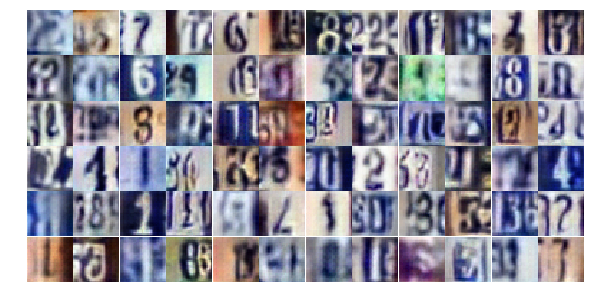

Epoch 13/20... Discriminator Loss: 0.7648... Generator Loss: 1.5805
Epoch 13/20... Discriminator Loss: 1.1234... Generator Loss: 0.6129
Epoch 13/20... Discriminator Loss: 1.1380... Generator Loss: 0.6130
Epoch 13/20... Discriminator Loss: 0.8761... Generator Loss: 1.8314
Epoch 13/20... Discriminator Loss: 0.9762... Generator Loss: 0.9578
Epoch 13/20... Discriminator Loss: 0.7476... Generator Loss: 1.3269
Epoch 13/20... Discriminator Loss: 0.8926... Generator Loss: 0.7885
Epoch 13/20... Discriminator Loss: 1.5069... Generator Loss: 0.3436
Epoch 13/20... Discriminator Loss: 0.9953... Generator Loss: 1.2941
Epoch 13/20... Discriminator Loss: 1.1738... Generator Loss: 0.7261


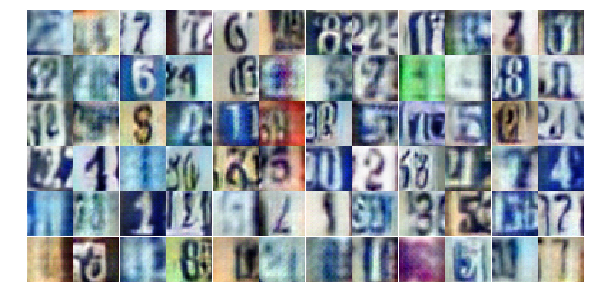

Epoch 13/20... Discriminator Loss: 0.8887... Generator Loss: 1.0151
Epoch 13/20... Discriminator Loss: 1.1133... Generator Loss: 0.6869
Epoch 13/20... Discriminator Loss: 1.1396... Generator Loss: 0.7672
Epoch 13/20... Discriminator Loss: 1.0594... Generator Loss: 0.8918
Epoch 13/20... Discriminator Loss: 1.0427... Generator Loss: 0.6145
Epoch 13/20... Discriminator Loss: 1.0795... Generator Loss: 0.6153
Epoch 13/20... Discriminator Loss: 0.8031... Generator Loss: 1.0677
Epoch 13/20... Discriminator Loss: 0.7018... Generator Loss: 1.1493
Epoch 13/20... Discriminator Loss: 0.8723... Generator Loss: 0.8036
Epoch 13/20... Discriminator Loss: 0.4515... Generator Loss: 2.1270


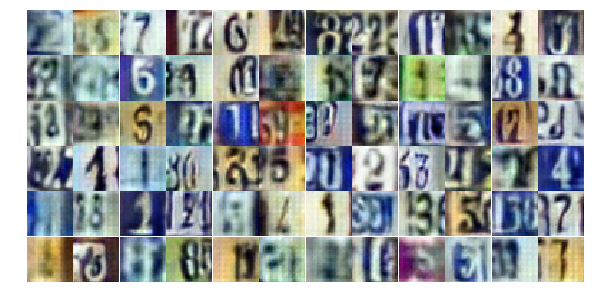

Epoch 13/20... Discriminator Loss: 1.1449... Generator Loss: 1.0934
Epoch 13/20... Discriminator Loss: 0.7764... Generator Loss: 1.1462
Epoch 13/20... Discriminator Loss: 1.0369... Generator Loss: 0.8365
Epoch 13/20... Discriminator Loss: 1.0054... Generator Loss: 1.3065
Epoch 13/20... Discriminator Loss: 1.0906... Generator Loss: 0.6955
Epoch 13/20... Discriminator Loss: 1.0419... Generator Loss: 1.3999
Epoch 13/20... Discriminator Loss: 0.6465... Generator Loss: 1.7966
Epoch 13/20... Discriminator Loss: 1.3682... Generator Loss: 0.4349
Epoch 13/20... Discriminator Loss: 0.8844... Generator Loss: 0.8092
Epoch 13/20... Discriminator Loss: 0.9617... Generator Loss: 0.9942


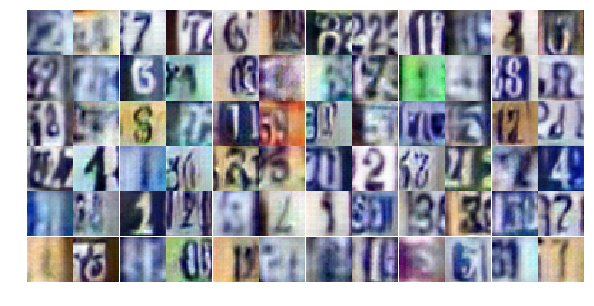

Epoch 13/20... Discriminator Loss: 1.2323... Generator Loss: 0.6172
Epoch 13/20... Discriminator Loss: 1.8382... Generator Loss: 0.2771
Epoch 13/20... Discriminator Loss: 1.4305... Generator Loss: 0.4742
Epoch 13/20... Discriminator Loss: 0.7316... Generator Loss: 1.2329
Epoch 13/20... Discriminator Loss: 1.2287... Generator Loss: 1.2148
Epoch 13/20... Discriminator Loss: 0.4408... Generator Loss: 1.5286
Epoch 13/20... Discriminator Loss: 0.8640... Generator Loss: 0.7745
Epoch 13/20... Discriminator Loss: 0.7478... Generator Loss: 1.0061
Epoch 13/20... Discriminator Loss: 1.0626... Generator Loss: 0.6483
Epoch 13/20... Discriminator Loss: 1.0351... Generator Loss: 0.7499


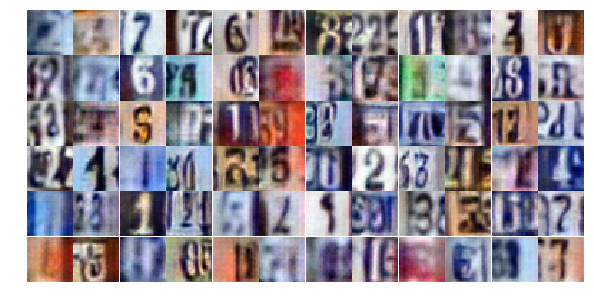

Epoch 13/20... Discriminator Loss: 0.4051... Generator Loss: 2.8514
Epoch 13/20... Discriminator Loss: 1.5824... Generator Loss: 0.4384
Epoch 13/20... Discriminator Loss: 1.3813... Generator Loss: 1.8792
Epoch 13/20... Discriminator Loss: 1.1345... Generator Loss: 0.7233
Epoch 14/20... Discriminator Loss: 1.0270... Generator Loss: 0.9331
Epoch 14/20... Discriminator Loss: 0.9470... Generator Loss: 0.8887
Epoch 14/20... Discriminator Loss: 1.5123... Generator Loss: 0.3852
Epoch 14/20... Discriminator Loss: 0.6147... Generator Loss: 2.0579
Epoch 14/20... Discriminator Loss: 1.2441... Generator Loss: 0.6809
Epoch 14/20... Discriminator Loss: 0.9155... Generator Loss: 0.7921


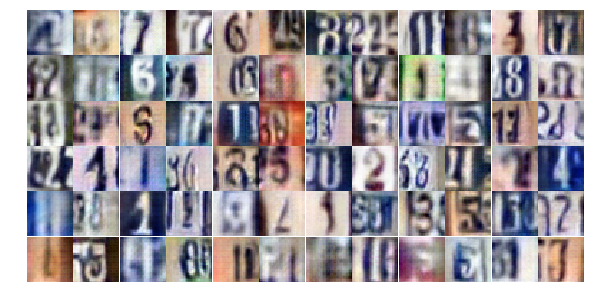

Epoch 14/20... Discriminator Loss: 2.1228... Generator Loss: 2.5596
Epoch 14/20... Discriminator Loss: 1.7185... Generator Loss: 0.2921
Epoch 14/20... Discriminator Loss: 0.6773... Generator Loss: 1.1848
Epoch 14/20... Discriminator Loss: 0.9833... Generator Loss: 0.6845
Epoch 14/20... Discriminator Loss: 1.4904... Generator Loss: 0.3399
Epoch 14/20... Discriminator Loss: 0.4946... Generator Loss: 1.8145
Epoch 14/20... Discriminator Loss: 0.7666... Generator Loss: 1.0383
Epoch 14/20... Discriminator Loss: 1.4494... Generator Loss: 0.4281
Epoch 14/20... Discriminator Loss: 1.7812... Generator Loss: 0.2722
Epoch 14/20... Discriminator Loss: 1.1972... Generator Loss: 0.5488


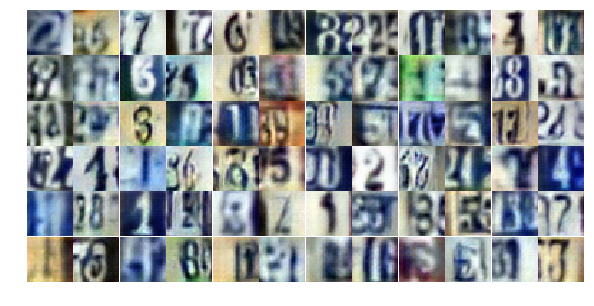

Epoch 14/20... Discriminator Loss: 0.6115... Generator Loss: 1.0907
Epoch 14/20... Discriminator Loss: 0.8389... Generator Loss: 1.8296
Epoch 14/20... Discriminator Loss: 0.9931... Generator Loss: 0.7491
Epoch 14/20... Discriminator Loss: 0.7592... Generator Loss: 0.9470
Epoch 14/20... Discriminator Loss: 0.8163... Generator Loss: 2.0795
Epoch 14/20... Discriminator Loss: 1.1736... Generator Loss: 0.6912
Epoch 14/20... Discriminator Loss: 1.5679... Generator Loss: 0.3560
Epoch 14/20... Discriminator Loss: 0.6493... Generator Loss: 1.1968
Epoch 14/20... Discriminator Loss: 0.6081... Generator Loss: 1.1636
Epoch 14/20... Discriminator Loss: 0.6138... Generator Loss: 1.2260


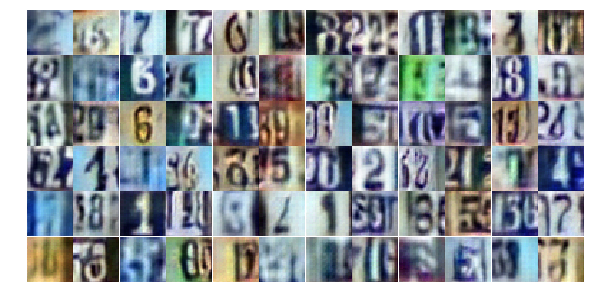

Epoch 14/20... Discriminator Loss: 1.6725... Generator Loss: 0.2713
Epoch 14/20... Discriminator Loss: 0.5271... Generator Loss: 1.2730
Epoch 14/20... Discriminator Loss: 0.5569... Generator Loss: 2.7246
Epoch 14/20... Discriminator Loss: 0.7167... Generator Loss: 1.2003
Epoch 14/20... Discriminator Loss: 1.4591... Generator Loss: 0.3849
Epoch 14/20... Discriminator Loss: 0.8611... Generator Loss: 0.8158
Epoch 14/20... Discriminator Loss: 1.3879... Generator Loss: 0.4486
Epoch 14/20... Discriminator Loss: 0.7621... Generator Loss: 1.8476
Epoch 14/20... Discriminator Loss: 0.3553... Generator Loss: 1.7698
Epoch 14/20... Discriminator Loss: 0.9907... Generator Loss: 0.7685


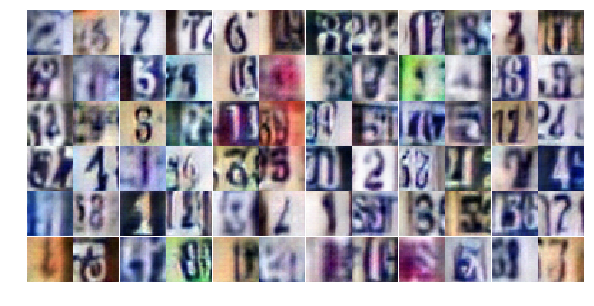

Epoch 14/20... Discriminator Loss: 1.0683... Generator Loss: 1.0248
Epoch 14/20... Discriminator Loss: 0.9661... Generator Loss: 1.3412
Epoch 14/20... Discriminator Loss: 1.3842... Generator Loss: 0.4437
Epoch 14/20... Discriminator Loss: 1.4116... Generator Loss: 0.4281
Epoch 14/20... Discriminator Loss: 0.8233... Generator Loss: 1.2007
Epoch 14/20... Discriminator Loss: 0.9202... Generator Loss: 1.0357
Epoch 14/20... Discriminator Loss: 0.8372... Generator Loss: 1.6720
Epoch 14/20... Discriminator Loss: 0.9579... Generator Loss: 0.8028
Epoch 14/20... Discriminator Loss: 1.3885... Generator Loss: 0.4091
Epoch 14/20... Discriminator Loss: 1.1037... Generator Loss: 2.1397


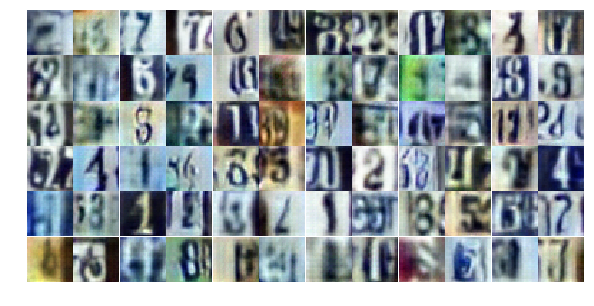

Epoch 14/20... Discriminator Loss: 1.0446... Generator Loss: 1.4325
Epoch 14/20... Discriminator Loss: 1.7184... Generator Loss: 0.3548
Epoch 14/20... Discriminator Loss: 0.4716... Generator Loss: 1.6095
Epoch 14/20... Discriminator Loss: 1.1581... Generator Loss: 0.7139
Epoch 14/20... Discriminator Loss: 1.6993... Generator Loss: 0.3369
Epoch 14/20... Discriminator Loss: 1.3293... Generator Loss: 0.4618
Epoch 14/20... Discriminator Loss: 1.6941... Generator Loss: 1.0884
Epoch 14/20... Discriminator Loss: 0.9613... Generator Loss: 0.8964
Epoch 14/20... Discriminator Loss: 0.2800... Generator Loss: 1.8363
Epoch 14/20... Discriminator Loss: 1.2465... Generator Loss: 0.6432


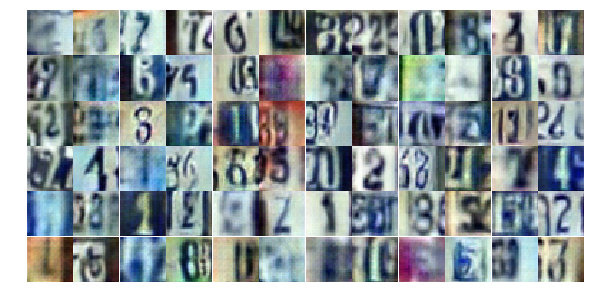

Epoch 14/20... Discriminator Loss: 1.1435... Generator Loss: 0.5603
Epoch 14/20... Discriminator Loss: 1.1140... Generator Loss: 0.6339
Epoch 15/20... Discriminator Loss: 1.1760... Generator Loss: 1.1868
Epoch 15/20... Discriminator Loss: 0.7096... Generator Loss: 1.2483
Epoch 15/20... Discriminator Loss: 1.1926... Generator Loss: 0.5387
Epoch 15/20... Discriminator Loss: 1.4079... Generator Loss: 0.4313
Epoch 15/20... Discriminator Loss: 0.7542... Generator Loss: 1.1150
Epoch 15/20... Discriminator Loss: 0.6708... Generator Loss: 1.3506
Epoch 15/20... Discriminator Loss: 1.1271... Generator Loss: 0.6893
Epoch 15/20... Discriminator Loss: 0.9550... Generator Loss: 0.6506


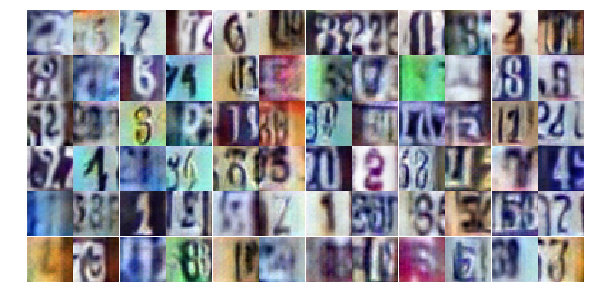

Epoch 15/20... Discriminator Loss: 1.2143... Generator Loss: 0.5745
Epoch 15/20... Discriminator Loss: 0.8767... Generator Loss: 1.1034
Epoch 15/20... Discriminator Loss: 1.1460... Generator Loss: 0.6992
Epoch 15/20... Discriminator Loss: 1.5732... Generator Loss: 0.4058
Epoch 15/20... Discriminator Loss: 1.4781... Generator Loss: 0.4269
Epoch 15/20... Discriminator Loss: 0.6864... Generator Loss: 1.1481
Epoch 15/20... Discriminator Loss: 0.8353... Generator Loss: 1.1330
Epoch 15/20... Discriminator Loss: 0.4203... Generator Loss: 1.9618
Epoch 15/20... Discriminator Loss: 0.8008... Generator Loss: 2.5255
Epoch 15/20... Discriminator Loss: 0.9791... Generator Loss: 0.8210


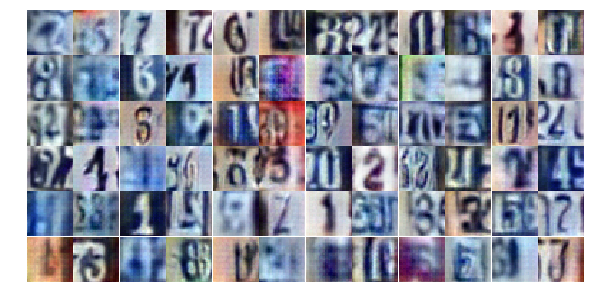

Epoch 15/20... Discriminator Loss: 1.0005... Generator Loss: 1.5375
Epoch 15/20... Discriminator Loss: 0.9829... Generator Loss: 0.9550
Epoch 15/20... Discriminator Loss: 0.3428... Generator Loss: 2.4126
Epoch 15/20... Discriminator Loss: 0.9445... Generator Loss: 0.9026
Epoch 15/20... Discriminator Loss: 0.4389... Generator Loss: 2.3127
Epoch 15/20... Discriminator Loss: 1.3739... Generator Loss: 0.5731
Epoch 15/20... Discriminator Loss: 0.8644... Generator Loss: 0.7875
Epoch 15/20... Discriminator Loss: 1.0905... Generator Loss: 0.6011
Epoch 15/20... Discriminator Loss: 0.8367... Generator Loss: 0.9380
Epoch 15/20... Discriminator Loss: 1.2243... Generator Loss: 0.4810


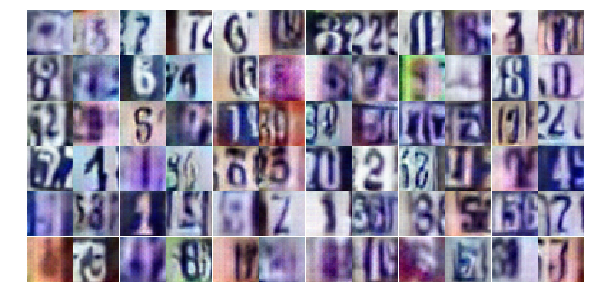

Epoch 15/20... Discriminator Loss: 0.9604... Generator Loss: 0.9477
Epoch 15/20... Discriminator Loss: 1.3089... Generator Loss: 0.5179
Epoch 15/20... Discriminator Loss: 0.9014... Generator Loss: 1.0680
Epoch 15/20... Discriminator Loss: 0.7408... Generator Loss: 1.0714
Epoch 15/20... Discriminator Loss: 0.6332... Generator Loss: 1.6897
Epoch 15/20... Discriminator Loss: 0.8807... Generator Loss: 1.0913
Epoch 15/20... Discriminator Loss: 0.9245... Generator Loss: 0.7558
Epoch 15/20... Discriminator Loss: 0.7737... Generator Loss: 1.0902
Epoch 15/20... Discriminator Loss: 0.8027... Generator Loss: 1.3035
Epoch 15/20... Discriminator Loss: 0.7010... Generator Loss: 1.3100


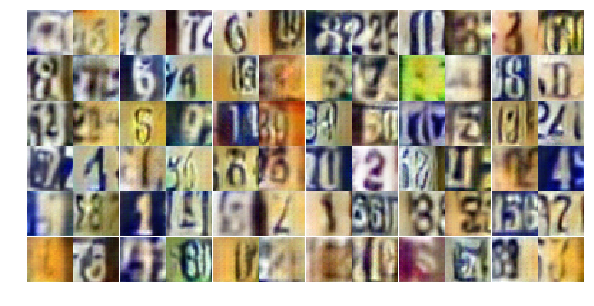

Epoch 15/20... Discriminator Loss: 0.7186... Generator Loss: 0.9426
Epoch 15/20... Discriminator Loss: 1.7346... Generator Loss: 0.3627
Epoch 15/20... Discriminator Loss: 1.3644... Generator Loss: 0.4820
Epoch 15/20... Discriminator Loss: 0.4492... Generator Loss: 2.5521
Epoch 15/20... Discriminator Loss: 1.6776... Generator Loss: 0.3682
Epoch 15/20... Discriminator Loss: 0.6763... Generator Loss: 1.7822
Epoch 15/20... Discriminator Loss: 1.0025... Generator Loss: 1.8570
Epoch 15/20... Discriminator Loss: 1.1269... Generator Loss: 0.7407
Epoch 15/20... Discriminator Loss: 1.5646... Generator Loss: 0.4079
Epoch 15/20... Discriminator Loss: 0.9408... Generator Loss: 1.1770


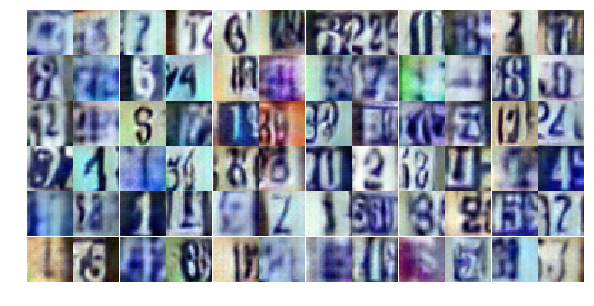

Epoch 15/20... Discriminator Loss: 1.5556... Generator Loss: 0.4046
Epoch 15/20... Discriminator Loss: 1.1385... Generator Loss: 0.6304
Epoch 15/20... Discriminator Loss: 1.1243... Generator Loss: 0.7028
Epoch 15/20... Discriminator Loss: 0.5711... Generator Loss: 1.1561
Epoch 15/20... Discriminator Loss: 0.5491... Generator Loss: 1.3837
Epoch 15/20... Discriminator Loss: 2.4850... Generator Loss: 4.2292
Epoch 15/20... Discriminator Loss: 1.4776... Generator Loss: 0.4418
Epoch 15/20... Discriminator Loss: 0.7881... Generator Loss: 1.2223
Epoch 15/20... Discriminator Loss: 1.4474... Generator Loss: 0.4391
Epoch 16/20... Discriminator Loss: 1.4657... Generator Loss: 0.4418


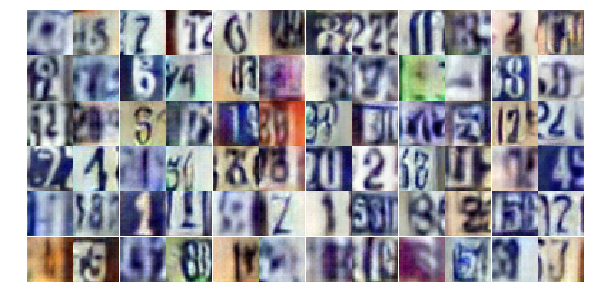

Epoch 16/20... Discriminator Loss: 0.8002... Generator Loss: 1.2507
Epoch 16/20... Discriminator Loss: 0.7476... Generator Loss: 0.9514
Epoch 16/20... Discriminator Loss: 0.8591... Generator Loss: 0.8132
Epoch 16/20... Discriminator Loss: 0.7396... Generator Loss: 1.1470
Epoch 16/20... Discriminator Loss: 1.4603... Generator Loss: 0.4407
Epoch 16/20... Discriminator Loss: 0.6676... Generator Loss: 1.0827
Epoch 16/20... Discriminator Loss: 2.0108... Generator Loss: 0.1926
Epoch 16/20... Discriminator Loss: 0.7515... Generator Loss: 1.0734
Epoch 16/20... Discriminator Loss: 1.1445... Generator Loss: 0.5772
Epoch 16/20... Discriminator Loss: 1.2430... Generator Loss: 0.5168


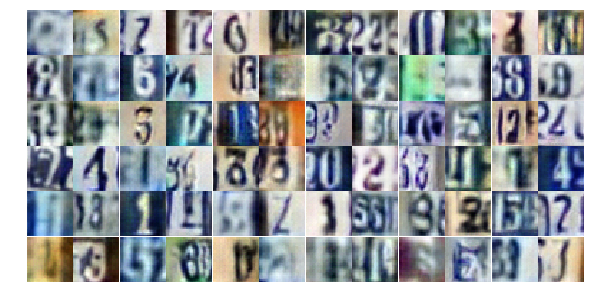

Epoch 16/20... Discriminator Loss: 1.6679... Generator Loss: 0.3760
Epoch 16/20... Discriminator Loss: 0.6356... Generator Loss: 1.6314
Epoch 16/20... Discriminator Loss: 0.7519... Generator Loss: 0.9962
Epoch 16/20... Discriminator Loss: 0.8546... Generator Loss: 0.8455
Epoch 16/20... Discriminator Loss: 1.4376... Generator Loss: 1.9339
Epoch 16/20... Discriminator Loss: 1.4833... Generator Loss: 0.6168
Epoch 16/20... Discriminator Loss: 1.0962... Generator Loss: 0.6180
Epoch 16/20... Discriminator Loss: 1.0420... Generator Loss: 0.8003
Epoch 16/20... Discriminator Loss: 0.7591... Generator Loss: 1.0776
Epoch 16/20... Discriminator Loss: 0.4810... Generator Loss: 1.7096


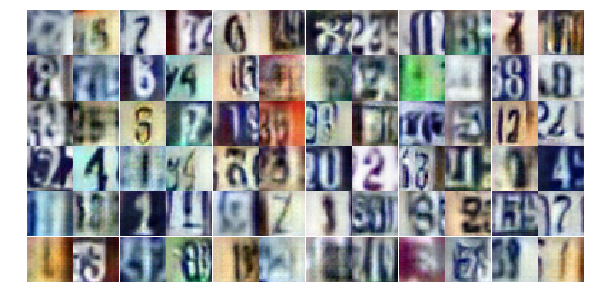

Epoch 16/20... Discriminator Loss: 0.8203... Generator Loss: 1.0199
Epoch 16/20... Discriminator Loss: 0.8558... Generator Loss: 0.9837
Epoch 16/20... Discriminator Loss: 1.2864... Generator Loss: 0.5448
Epoch 16/20... Discriminator Loss: 1.2061... Generator Loss: 0.5479
Epoch 16/20... Discriminator Loss: 1.0748... Generator Loss: 0.7524
Epoch 16/20... Discriminator Loss: 0.8036... Generator Loss: 1.0769
Epoch 16/20... Discriminator Loss: 1.5581... Generator Loss: 0.3562
Epoch 16/20... Discriminator Loss: 0.8749... Generator Loss: 0.9835
Epoch 16/20... Discriminator Loss: 1.5489... Generator Loss: 0.3817
Epoch 16/20... Discriminator Loss: 0.8586... Generator Loss: 0.8498


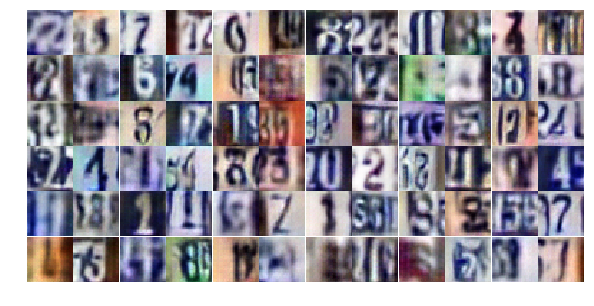

Epoch 16/20... Discriminator Loss: 0.2764... Generator Loss: 2.1502
Epoch 16/20... Discriminator Loss: 1.2916... Generator Loss: 0.4707
Epoch 16/20... Discriminator Loss: 0.8389... Generator Loss: 1.3412
Epoch 16/20... Discriminator Loss: 0.8236... Generator Loss: 1.0344
Epoch 16/20... Discriminator Loss: 1.1737... Generator Loss: 0.6274
Epoch 16/20... Discriminator Loss: 0.8260... Generator Loss: 1.4816
Epoch 16/20... Discriminator Loss: 1.0243... Generator Loss: 0.7934
Epoch 16/20... Discriminator Loss: 1.7225... Generator Loss: 0.3215
Epoch 16/20... Discriminator Loss: 0.5138... Generator Loss: 1.4992
Epoch 16/20... Discriminator Loss: 0.4577... Generator Loss: 3.0219


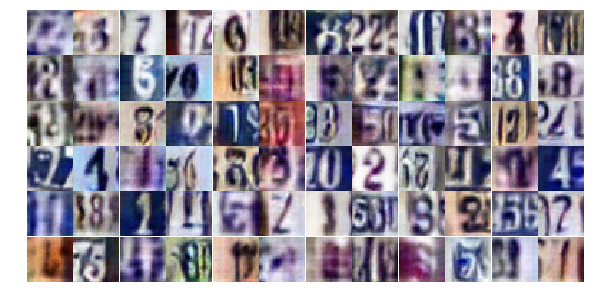

Epoch 16/20... Discriminator Loss: 0.9943... Generator Loss: 1.9654
Epoch 16/20... Discriminator Loss: 0.7063... Generator Loss: 1.3142
Epoch 16/20... Discriminator Loss: 1.4405... Generator Loss: 0.4379
Epoch 16/20... Discriminator Loss: 0.9585... Generator Loss: 1.3217
Epoch 16/20... Discriminator Loss: 0.9271... Generator Loss: 0.9780
Epoch 16/20... Discriminator Loss: 1.6398... Generator Loss: 0.3838
Epoch 16/20... Discriminator Loss: 0.7609... Generator Loss: 1.1784
Epoch 16/20... Discriminator Loss: 0.9402... Generator Loss: 0.8523
Epoch 16/20... Discriminator Loss: 0.5180... Generator Loss: 1.3248
Epoch 16/20... Discriminator Loss: 0.5547... Generator Loss: 1.3193


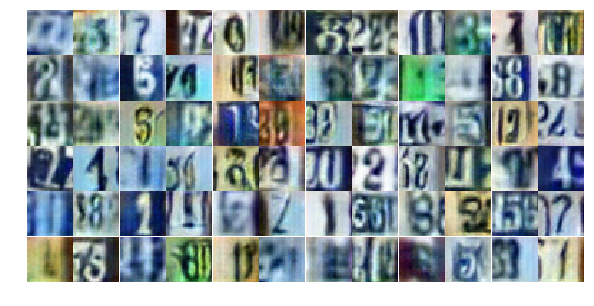

Epoch 16/20... Discriminator Loss: 0.5835... Generator Loss: 1.4577
Epoch 16/20... Discriminator Loss: 1.5406... Generator Loss: 0.4069
Epoch 16/20... Discriminator Loss: 1.9799... Generator Loss: 0.2311
Epoch 16/20... Discriminator Loss: 0.9800... Generator Loss: 0.7730
Epoch 16/20... Discriminator Loss: 0.8450... Generator Loss: 1.3865
Epoch 16/20... Discriminator Loss: 0.7222... Generator Loss: 1.3586
Epoch 17/20... Discriminator Loss: 0.5553... Generator Loss: 1.3804
Epoch 17/20... Discriminator Loss: 0.9378... Generator Loss: 0.9217
Epoch 17/20... Discriminator Loss: 1.3268... Generator Loss: 0.5107
Epoch 17/20... Discriminator Loss: 0.5973... Generator Loss: 1.2924


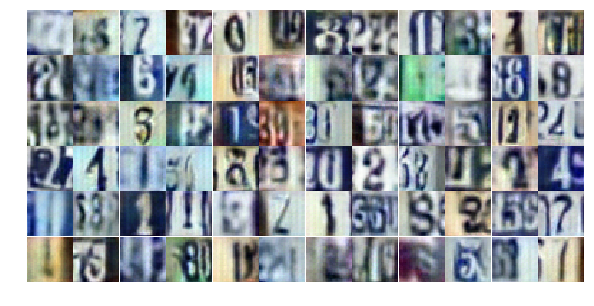

Epoch 17/20... Discriminator Loss: 0.4484... Generator Loss: 2.1036
Epoch 17/20... Discriminator Loss: 0.6371... Generator Loss: 1.3085
Epoch 17/20... Discriminator Loss: 1.8317... Generator Loss: 0.3295
Epoch 17/20... Discriminator Loss: 0.9210... Generator Loss: 0.8609
Epoch 17/20... Discriminator Loss: 0.9714... Generator Loss: 1.1536
Epoch 17/20... Discriminator Loss: 1.0970... Generator Loss: 1.0311
Epoch 17/20... Discriminator Loss: 1.0150... Generator Loss: 0.8396
Epoch 17/20... Discriminator Loss: 0.9916... Generator Loss: 0.7654
Epoch 17/20... Discriminator Loss: 0.5835... Generator Loss: 1.1867
Epoch 17/20... Discriminator Loss: 1.0448... Generator Loss: 0.6892


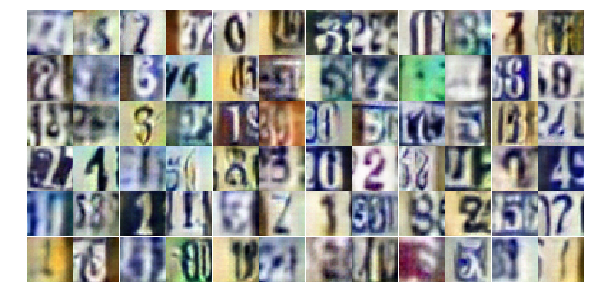

Epoch 17/20... Discriminator Loss: 0.7854... Generator Loss: 1.8863
Epoch 17/20... Discriminator Loss: 0.6410... Generator Loss: 2.0199
Epoch 17/20... Discriminator Loss: 0.5645... Generator Loss: 1.9681
Epoch 17/20... Discriminator Loss: 0.9665... Generator Loss: 0.9557
Epoch 17/20... Discriminator Loss: 1.0618... Generator Loss: 3.2395
Epoch 17/20... Discriminator Loss: 1.9083... Generator Loss: 0.3126
Epoch 17/20... Discriminator Loss: 0.5576... Generator Loss: 1.6186
Epoch 17/20... Discriminator Loss: 1.2256... Generator Loss: 0.5916
Epoch 17/20... Discriminator Loss: 1.0141... Generator Loss: 0.8924
Epoch 17/20... Discriminator Loss: 0.4280... Generator Loss: 1.5793


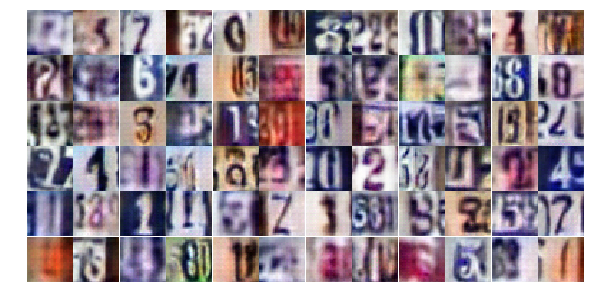

Epoch 17/20... Discriminator Loss: 1.7214... Generator Loss: 0.3337
Epoch 17/20... Discriminator Loss: 0.3842... Generator Loss: 2.7865
Epoch 17/20... Discriminator Loss: 0.3014... Generator Loss: 5.5221
Epoch 17/20... Discriminator Loss: 1.6865... Generator Loss: 0.3416
Epoch 17/20... Discriminator Loss: 2.5181... Generator Loss: 0.1730
Epoch 17/20... Discriminator Loss: 0.6050... Generator Loss: 1.2367
Epoch 17/20... Discriminator Loss: 1.3607... Generator Loss: 0.5122
Epoch 17/20... Discriminator Loss: 1.3773... Generator Loss: 0.4969
Epoch 17/20... Discriminator Loss: 1.0018... Generator Loss: 0.7984
Epoch 17/20... Discriminator Loss: 0.5349... Generator Loss: 1.6160


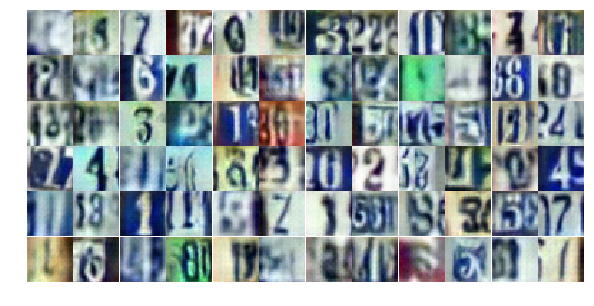

Epoch 17/20... Discriminator Loss: 1.5368... Generator Loss: 0.4013
Epoch 17/20... Discriminator Loss: 1.3129... Generator Loss: 1.3550
Epoch 17/20... Discriminator Loss: 0.7765... Generator Loss: 2.9588
Epoch 17/20... Discriminator Loss: 0.8132... Generator Loss: 1.2658
Epoch 17/20... Discriminator Loss: 0.6564... Generator Loss: 1.7364
Epoch 17/20... Discriminator Loss: 0.6916... Generator Loss: 1.8538
Epoch 17/20... Discriminator Loss: 0.9467... Generator Loss: 0.9805
Epoch 17/20... Discriminator Loss: 0.4919... Generator Loss: 2.8745
Epoch 17/20... Discriminator Loss: 0.4753... Generator Loss: 1.8653
Epoch 17/20... Discriminator Loss: 0.5814... Generator Loss: 1.3771


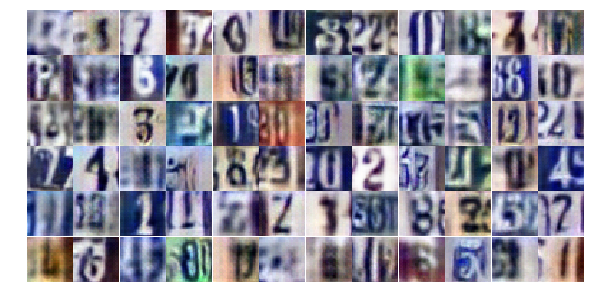

Epoch 17/20... Discriminator Loss: 0.9686... Generator Loss: 1.3939
Epoch 17/20... Discriminator Loss: 0.5501... Generator Loss: 1.6335
Epoch 17/20... Discriminator Loss: 1.3971... Generator Loss: 2.3026
Epoch 17/20... Discriminator Loss: 0.5048... Generator Loss: 2.1460
Epoch 17/20... Discriminator Loss: 1.0652... Generator Loss: 0.8600
Epoch 17/20... Discriminator Loss: 1.1003... Generator Loss: 0.6089
Epoch 17/20... Discriminator Loss: 1.8235... Generator Loss: 0.3095
Epoch 17/20... Discriminator Loss: 0.9002... Generator Loss: 1.2074
Epoch 17/20... Discriminator Loss: 1.6110... Generator Loss: 0.5535
Epoch 17/20... Discriminator Loss: 1.4530... Generator Loss: 0.4305


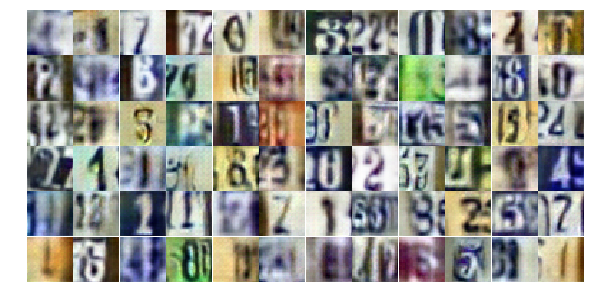

Epoch 17/20... Discriminator Loss: 0.9900... Generator Loss: 0.9073
Epoch 17/20... Discriminator Loss: 1.2938... Generator Loss: 0.5465
Epoch 17/20... Discriminator Loss: 0.4127... Generator Loss: 1.7400
Epoch 17/20... Discriminator Loss: 0.5188... Generator Loss: 1.4572
Epoch 18/20... Discriminator Loss: 1.5181... Generator Loss: 0.4146
Epoch 18/20... Discriminator Loss: 1.5757... Generator Loss: 0.3416
Epoch 18/20... Discriminator Loss: 0.7455... Generator Loss: 0.9954
Epoch 18/20... Discriminator Loss: 0.9773... Generator Loss: 0.7357
Epoch 18/20... Discriminator Loss: 0.4500... Generator Loss: 1.4432
Epoch 18/20... Discriminator Loss: 1.7693... Generator Loss: 0.4046


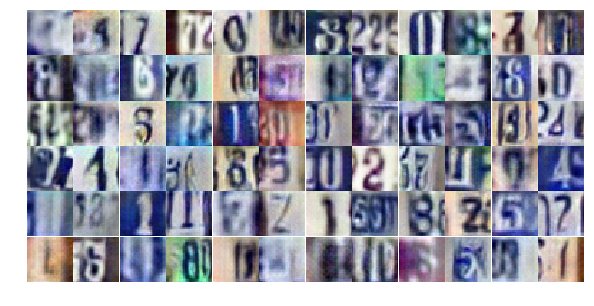

Epoch 18/20... Discriminator Loss: 0.6817... Generator Loss: 0.9720
Epoch 18/20... Discriminator Loss: 0.8515... Generator Loss: 0.9544
Epoch 18/20... Discriminator Loss: 0.7978... Generator Loss: 0.9816
Epoch 18/20... Discriminator Loss: 0.8000... Generator Loss: 1.2975
Epoch 18/20... Discriminator Loss: 1.0931... Generator Loss: 0.6569
Epoch 18/20... Discriminator Loss: 1.7639... Generator Loss: 0.3332
Epoch 18/20... Discriminator Loss: 0.6064... Generator Loss: 1.7983
Epoch 18/20... Discriminator Loss: 1.2627... Generator Loss: 0.5579
Epoch 18/20... Discriminator Loss: 0.5547... Generator Loss: 1.8679
Epoch 18/20... Discriminator Loss: 0.5156... Generator Loss: 1.6679


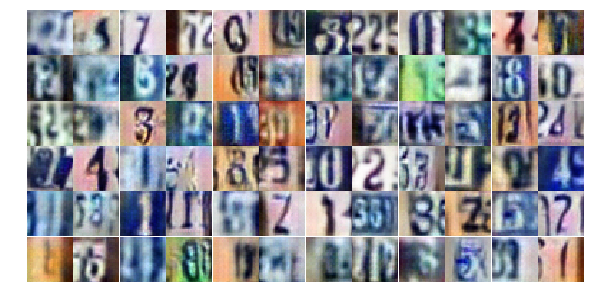

Epoch 18/20... Discriminator Loss: 1.4726... Generator Loss: 0.4834
Epoch 18/20... Discriminator Loss: 1.2569... Generator Loss: 0.5656
Epoch 18/20... Discriminator Loss: 1.2882... Generator Loss: 0.6086
Epoch 18/20... Discriminator Loss: 0.9932... Generator Loss: 0.7522
Epoch 18/20... Discriminator Loss: 1.2390... Generator Loss: 0.5457
Epoch 18/20... Discriminator Loss: 1.1003... Generator Loss: 0.6635
Epoch 18/20... Discriminator Loss: 1.3799... Generator Loss: 0.5080
Epoch 18/20... Discriminator Loss: 1.3166... Generator Loss: 0.6027
Epoch 18/20... Discriminator Loss: 1.1425... Generator Loss: 0.7077
Epoch 18/20... Discriminator Loss: 0.9151... Generator Loss: 0.8973


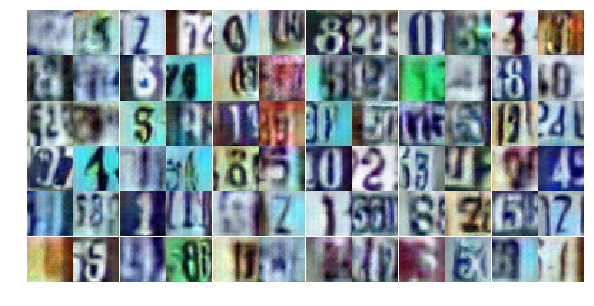

Epoch 18/20... Discriminator Loss: 0.6043... Generator Loss: 1.7359
Epoch 18/20... Discriminator Loss: 0.8360... Generator Loss: 1.5152
Epoch 18/20... Discriminator Loss: 0.6932... Generator Loss: 1.0029
Epoch 18/20... Discriminator Loss: 0.7772... Generator Loss: 1.0386
Epoch 18/20... Discriminator Loss: 2.1191... Generator Loss: 0.2222
Epoch 18/20... Discriminator Loss: 0.5022... Generator Loss: 1.3692
Epoch 18/20... Discriminator Loss: 1.1724... Generator Loss: 0.7619
Epoch 18/20... Discriminator Loss: 1.3925... Generator Loss: 2.0737
Epoch 18/20... Discriminator Loss: 0.5078... Generator Loss: 1.6958
Epoch 18/20... Discriminator Loss: 1.0055... Generator Loss: 0.7334


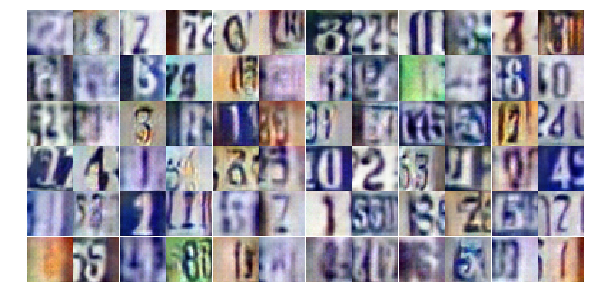

Epoch 18/20... Discriminator Loss: 0.8157... Generator Loss: 0.9987
Epoch 18/20... Discriminator Loss: 0.5832... Generator Loss: 1.2060
Epoch 18/20... Discriminator Loss: 1.0204... Generator Loss: 0.9424
Epoch 18/20... Discriminator Loss: 0.6201... Generator Loss: 1.3351
Epoch 18/20... Discriminator Loss: 1.3202... Generator Loss: 0.5369
Epoch 18/20... Discriminator Loss: 0.5203... Generator Loss: 1.2732
Epoch 18/20... Discriminator Loss: 1.4216... Generator Loss: 0.4206
Epoch 18/20... Discriminator Loss: 0.8901... Generator Loss: 1.6830
Epoch 18/20... Discriminator Loss: 1.3714... Generator Loss: 0.5584
Epoch 18/20... Discriminator Loss: 0.6153... Generator Loss: 1.4304


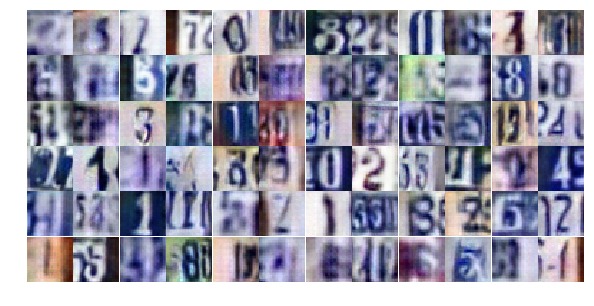

Epoch 18/20... Discriminator Loss: 0.4842... Generator Loss: 1.8152
Epoch 18/20... Discriminator Loss: 1.0619... Generator Loss: 0.6411
Epoch 18/20... Discriminator Loss: 1.9322... Generator Loss: 3.7462
Epoch 18/20... Discriminator Loss: 1.0356... Generator Loss: 1.1233
Epoch 18/20... Discriminator Loss: 1.2335... Generator Loss: 0.6295
Epoch 18/20... Discriminator Loss: 0.8427... Generator Loss: 1.2162
Epoch 18/20... Discriminator Loss: 0.3201... Generator Loss: 1.7691
Epoch 18/20... Discriminator Loss: 0.5840... Generator Loss: 1.2421
Epoch 18/20... Discriminator Loss: 1.2222... Generator Loss: 1.5737
Epoch 18/20... Discriminator Loss: 1.3140... Generator Loss: 0.6490


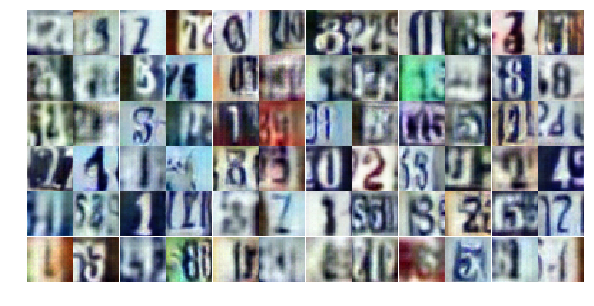

Epoch 18/20... Discriminator Loss: 0.6099... Generator Loss: 2.9347
Epoch 19/20... Discriminator Loss: 1.4434... Generator Loss: 0.4728
Epoch 19/20... Discriminator Loss: 0.3482... Generator Loss: 1.9086
Epoch 19/20... Discriminator Loss: 0.6859... Generator Loss: 1.1032
Epoch 19/20... Discriminator Loss: 1.1287... Generator Loss: 0.6470
Epoch 19/20... Discriminator Loss: 0.5253... Generator Loss: 1.3674
Epoch 19/20... Discriminator Loss: 1.0695... Generator Loss: 0.6877
Epoch 19/20... Discriminator Loss: 0.8808... Generator Loss: 0.9034
Epoch 19/20... Discriminator Loss: 0.6976... Generator Loss: 1.0965
Epoch 19/20... Discriminator Loss: 1.0645... Generator Loss: 1.0079


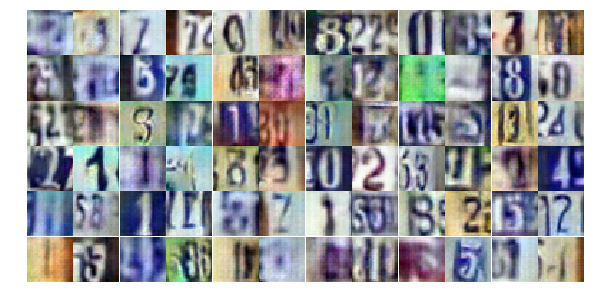

Epoch 19/20... Discriminator Loss: 0.8155... Generator Loss: 0.8840
Epoch 19/20... Discriminator Loss: 0.8207... Generator Loss: 0.9592
Epoch 19/20... Discriminator Loss: 0.5365... Generator Loss: 1.3533
Epoch 19/20... Discriminator Loss: 0.7163... Generator Loss: 1.0584
Epoch 19/20... Discriminator Loss: 0.8592... Generator Loss: 1.0057
Epoch 19/20... Discriminator Loss: 0.7545... Generator Loss: 2.0400
Epoch 19/20... Discriminator Loss: 1.6979... Generator Loss: 0.3862
Epoch 19/20... Discriminator Loss: 0.4044... Generator Loss: 1.5620
Epoch 19/20... Discriminator Loss: 0.7027... Generator Loss: 1.0670
Epoch 19/20... Discriminator Loss: 2.0908... Generator Loss: 0.2102


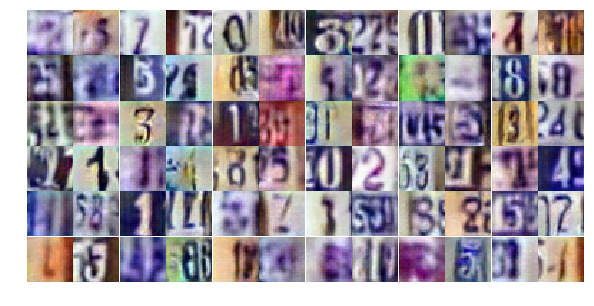

Epoch 19/20... Discriminator Loss: 0.4106... Generator Loss: 1.8388
Epoch 19/20... Discriminator Loss: 1.8918... Generator Loss: 3.2744
Epoch 19/20... Discriminator Loss: 1.2279... Generator Loss: 0.5310
Epoch 19/20... Discriminator Loss: 0.8863... Generator Loss: 0.9953
Epoch 19/20... Discriminator Loss: 1.8784... Generator Loss: 0.2980
Epoch 19/20... Discriminator Loss: 1.6429... Generator Loss: 3.4697
Epoch 19/20... Discriminator Loss: 1.0260... Generator Loss: 0.9804
Epoch 19/20... Discriminator Loss: 0.8791... Generator Loss: 1.1324
Epoch 19/20... Discriminator Loss: 1.1213... Generator Loss: 0.7437
Epoch 19/20... Discriminator Loss: 1.0633... Generator Loss: 0.7841


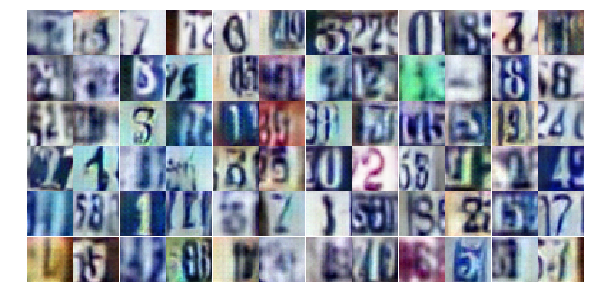

Epoch 19/20... Discriminator Loss: 0.8047... Generator Loss: 1.4818
Epoch 19/20... Discriminator Loss: 0.8767... Generator Loss: 0.8873
Epoch 19/20... Discriminator Loss: 0.7719... Generator Loss: 0.9592
Epoch 19/20... Discriminator Loss: 0.6564... Generator Loss: 1.3492
Epoch 19/20... Discriminator Loss: 0.7669... Generator Loss: 1.2281
Epoch 19/20... Discriminator Loss: 1.1728... Generator Loss: 0.6185
Epoch 19/20... Discriminator Loss: 0.7585... Generator Loss: 1.1537
Epoch 19/20... Discriminator Loss: 0.6024... Generator Loss: 1.9883
Epoch 19/20... Discriminator Loss: 0.5310... Generator Loss: 1.2943
Epoch 19/20... Discriminator Loss: 0.4931... Generator Loss: 1.4273


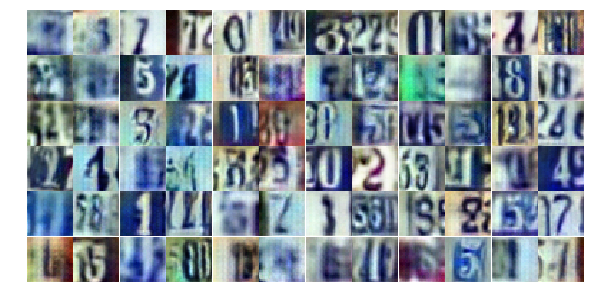

Epoch 19/20... Discriminator Loss: 1.5389... Generator Loss: 0.3605
Epoch 19/20... Discriminator Loss: 0.8282... Generator Loss: 0.9558
Epoch 19/20... Discriminator Loss: 1.1739... Generator Loss: 0.6442
Epoch 19/20... Discriminator Loss: 0.4077... Generator Loss: 1.5450
Epoch 19/20... Discriminator Loss: 0.7611... Generator Loss: 1.0438
Epoch 19/20... Discriminator Loss: 2.8314... Generator Loss: 2.2612
Epoch 19/20... Discriminator Loss: 1.1967... Generator Loss: 0.7690
Epoch 19/20... Discriminator Loss: 0.5959... Generator Loss: 1.6841
Epoch 19/20... Discriminator Loss: 0.4799... Generator Loss: 2.2825
Epoch 19/20... Discriminator Loss: 0.8601... Generator Loss: 2.0460


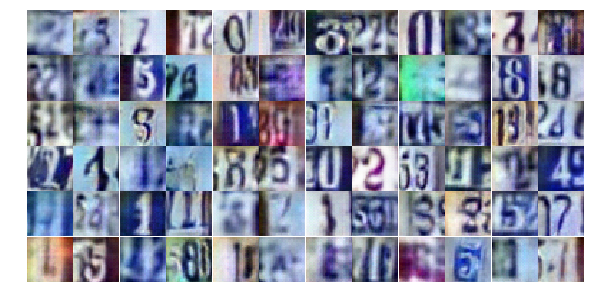

Epoch 19/20... Discriminator Loss: 0.6831... Generator Loss: 1.3556
Epoch 19/20... Discriminator Loss: 0.6099... Generator Loss: 1.6642
Epoch 19/20... Discriminator Loss: 1.8197... Generator Loss: 2.1481
Epoch 19/20... Discriminator Loss: 1.0156... Generator Loss: 0.7605
Epoch 19/20... Discriminator Loss: 0.6982... Generator Loss: 1.6165
Epoch 19/20... Discriminator Loss: 1.3913... Generator Loss: 0.4879
Epoch 19/20... Discriminator Loss: 1.2961... Generator Loss: 0.4671
Epoch 19/20... Discriminator Loss: 0.3040... Generator Loss: 1.8116
Epoch 20/20... Discriminator Loss: 0.8429... Generator Loss: 0.9296
Epoch 20/20... Discriminator Loss: 0.7343... Generator Loss: 1.2347


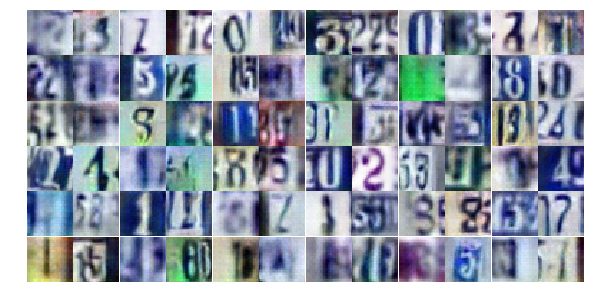

Epoch 20/20... Discriminator Loss: 1.3368... Generator Loss: 0.6015
Epoch 20/20... Discriminator Loss: 0.7671... Generator Loss: 1.1942
Epoch 20/20... Discriminator Loss: 1.3367... Generator Loss: 0.4475
Epoch 20/20... Discriminator Loss: 1.3576... Generator Loss: 0.5969
Epoch 20/20... Discriminator Loss: 0.7534... Generator Loss: 1.0849
Epoch 20/20... Discriminator Loss: 0.8022... Generator Loss: 1.1651
Epoch 20/20... Discriminator Loss: 0.5541... Generator Loss: 1.1679
Epoch 20/20... Discriminator Loss: 1.0510... Generator Loss: 0.6694
Epoch 20/20... Discriminator Loss: 1.0976... Generator Loss: 0.7751
Epoch 20/20... Discriminator Loss: 0.6253... Generator Loss: 1.6925


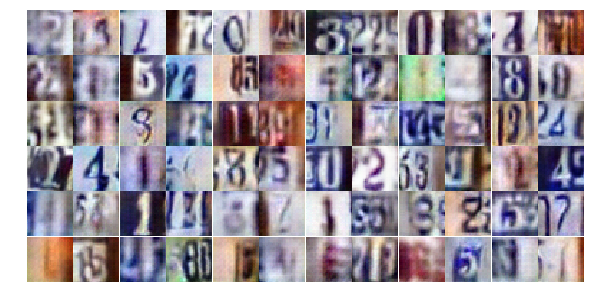

Epoch 20/20... Discriminator Loss: 1.1272... Generator Loss: 0.6444
Epoch 20/20... Discriminator Loss: 1.3033... Generator Loss: 0.5547
Epoch 20/20... Discriminator Loss: 1.0858... Generator Loss: 0.9069
Epoch 20/20... Discriminator Loss: 0.9692... Generator Loss: 0.8921
Epoch 20/20... Discriminator Loss: 0.9950... Generator Loss: 0.7381
Epoch 20/20... Discriminator Loss: 1.3780... Generator Loss: 0.5510
Epoch 20/20... Discriminator Loss: 1.6957... Generator Loss: 0.3214
Epoch 20/20... Discriminator Loss: 0.8134... Generator Loss: 1.2170
Epoch 20/20... Discriminator Loss: 0.8792... Generator Loss: 1.2735
Epoch 20/20... Discriminator Loss: 0.9633... Generator Loss: 1.8416


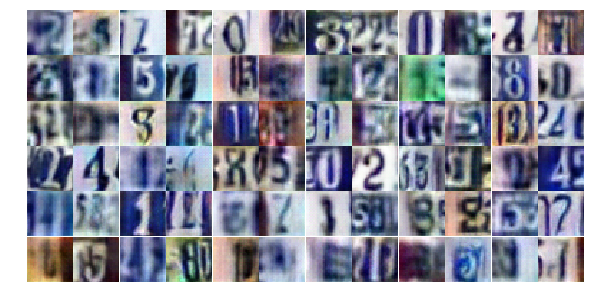

Epoch 20/20... Discriminator Loss: 0.7635... Generator Loss: 1.2635
Epoch 20/20... Discriminator Loss: 1.1575... Generator Loss: 0.5976
Epoch 20/20... Discriminator Loss: 1.0827... Generator Loss: 0.5659
Epoch 20/20... Discriminator Loss: 1.9893... Generator Loss: 0.2166
Epoch 20/20... Discriminator Loss: 2.5242... Generator Loss: 0.2447
Epoch 20/20... Discriminator Loss: 0.6334... Generator Loss: 1.4627
Epoch 20/20... Discriminator Loss: 1.0037... Generator Loss: 2.5495
Epoch 20/20... Discriminator Loss: 2.0785... Generator Loss: 0.2335
Epoch 20/20... Discriminator Loss: 0.8661... Generator Loss: 0.8172
Epoch 20/20... Discriminator Loss: 0.2335... Generator Loss: 2.8220


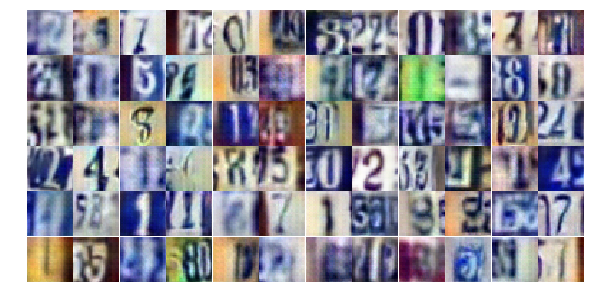

Epoch 20/20... Discriminator Loss: 1.7159... Generator Loss: 0.3845
Epoch 20/20... Discriminator Loss: 1.1992... Generator Loss: 0.5636
Epoch 20/20... Discriminator Loss: 2.4287... Generator Loss: 0.2115
Epoch 20/20... Discriminator Loss: 0.7996... Generator Loss: 1.4522
Epoch 20/20... Discriminator Loss: 1.3418... Generator Loss: 0.5183
Epoch 20/20... Discriminator Loss: 0.6984... Generator Loss: 1.3097
Epoch 20/20... Discriminator Loss: 0.8455... Generator Loss: 0.9301
Epoch 20/20... Discriminator Loss: 2.0681... Generator Loss: 0.2276
Epoch 20/20... Discriminator Loss: 0.9290... Generator Loss: 2.1418
Epoch 20/20... Discriminator Loss: 1.1387... Generator Loss: 0.6660


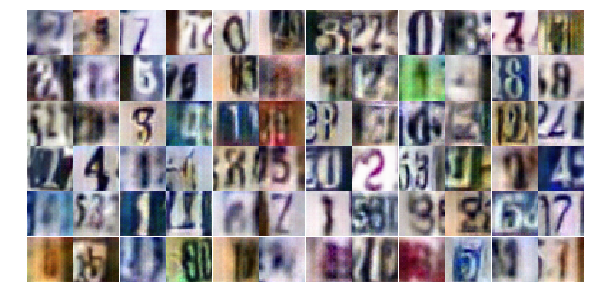

Epoch 20/20... Discriminator Loss: 1.6272... Generator Loss: 0.4700
Epoch 20/20... Discriminator Loss: 0.9355... Generator Loss: 0.9737
Epoch 20/20... Discriminator Loss: 0.6870... Generator Loss: 2.4841
Epoch 20/20... Discriminator Loss: 0.3566... Generator Loss: 2.4871
Epoch 20/20... Discriminator Loss: 0.9646... Generator Loss: 0.8380
Epoch 20/20... Discriminator Loss: 0.8179... Generator Loss: 1.0329
Epoch 20/20... Discriminator Loss: 0.3005... Generator Loss: 1.9467
Epoch 20/20... Discriminator Loss: 0.6827... Generator Loss: 1.6285
Epoch 20/20... Discriminator Loss: 0.6630... Generator Loss: 1.6716
Epoch 20/20... Discriminator Loss: 0.2379... Generator Loss: 3.1198


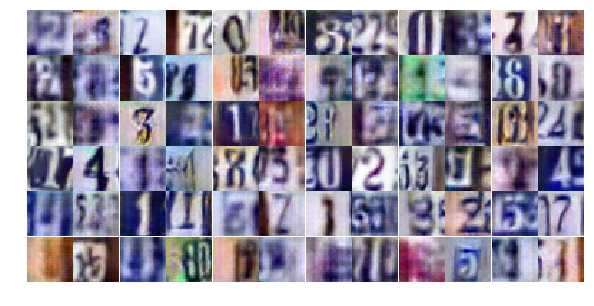

Epoch 20/20... Discriminator Loss: 1.2055... Generator Loss: 0.6041
Epoch 20/20... Discriminator Loss: 0.7193... Generator Loss: 1.3857
Epoch 20/20... Discriminator Loss: 0.4801... Generator Loss: 1.2724
Epoch 20/20... Discriminator Loss: 0.9551... Generator Loss: 0.8909
Epoch 20/20... Discriminator Loss: 0.6214... Generator Loss: 1.4194
Epoch 20/20... Discriminator Loss: 0.6860... Generator Loss: 1.1082


In [103]:
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

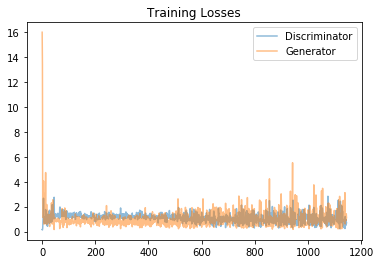

In [104]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

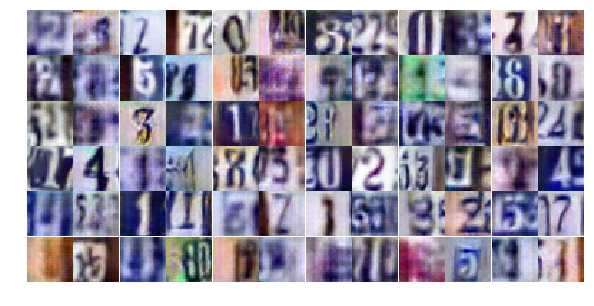

In [105]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))